## Introduction


In this project, we aim to build a robust model for classifying and localizing two specific animal species: Penguins and Turtles. We will utilize the VGG16 architecture, a well-known CNN model, in two distinct ways:

1. **From Scratch:** Construct and train a VGG16 model from scratch to classify and localize Penguins and Turtles in images.
2. **Transfer Learning:** Leverage a pre-trained VGG16 model, fine-tuning it to our specific dataset to improve performance and reduce training time.

We will evaluate both models based on their classification accuracy and the Intersection over Union (IoU) metric for localization, providing a comprehensive analysis of their capabilities and performance. The dataset includes labeled images with bounding box annotations, enabling the model to learn both the category and location of the animals within the images.

Also, we will take a look of other model such as EfficientNetV2S.



# Import Libraries and Preprocess Data
Here are the required libraries and global parameter that we use throughout the code

1. **os:** Provides a way of reading or writing to the file system.
2. **pandas as pd:** A powerful data manipulation library used for data analysis and handling data structures like dataframes.
3. **numpy as np:** A fundamental package for scientific computing with Python, providing support for arrays and matrices, along with a collection of mathematical functions.
4. **cv2 (OpenCV):** An open-source computer vision library used for image processing tasks, such as reading images and performing image transformations.
5. **matplotlib.pyplot as plt:** A plotting library used for creating static, animated, and interactive visualizations in Python.
6. **tensorflow as tf:** An end-to-end open-source platform for machine learning, providing a comprehensive ecosystem of tools, libraries, and community resources.
7. **tensorflow.keras:** A high-level API for building and training deep learning models.
8. **sklearn.preprocessing.LabelBinarizer:** A part of the scikit-learn library, used for converting categorical labels into a binary format.
9. **pickle:** A Python module used for serializing and de-serializing Python object structures, useful for saving and loading models.
10. **sklearn.model_selection.train_test_split:** A utility function from scikit-learn used to split arrays or matrices into random train and test subsets.

In [2]:
import os
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt 
from tensorflow.python.keras.utils.np_utils import to_categorical
import tensorflow as tf

from tensorflow import keras
from sklearn.preprocessing import LabelBinarizer
import pickle
from sklearn.model_selection import train_test_split

# setup label binariezer
lb = LabelBinarizer()

# Preprocess data

The data provided is very structured and detailed. Therefore, we can just read and organize the data (No validation needed).

As we are using CNN to classify and predict it bounding box, we will need to extract the info from the annotation.

In [3]:
def preprocess_annotations(df, image_dir):
    # Convert 'category_id' to int64 if necessary
    df['category_id'] = df['category_id'].astype('int64')
    # Replace numeric class designation with the text label of the class
    df['category_id'] = df['category_id'].replace({1: 'Penguin', 2: 'Turtle'})
    # Create the full filepath in the 'filepaths' column
    df['filepaths'] = [os.path.join(image_dir, file_path) for file_path in sorted(os.listdir(image_dir))]
    # Drop unnecessary columns
    df.drop(['id', 'area', 'segmentation', 'iscrowd'], axis=1, inplace=True)
    images = [] # store image
    bboxes = [] # store top left point and bottom right point of a pounding box
    labels =[] # store image class
    for i, row in df.iterrows():        
        image_path = row["filepaths"]
        (minX, minY, w, h) = row['bbox']
        maxX = minX + w
        maxY = minY + h
        
        image = cv2.imread(image_path)
        (height, width) = image.shape[:2]
        
        minX = float(minX) / width
        maxX = float(maxX) / width
        minY = float(minY) / height
        maxY = float(maxY) / height
        
        image = tf.keras.utils.img_to_array(tf.keras.utils.load_img(image_path, target_size=(224, 224)))
        
        images.append(image)
        labels.append(row['category_id'])
        bboxes.append((minX, minY, maxX, maxY))
    
    images = np.array(images, dtype="float32") / 255.0
    bboxes = np.array(bboxes, dtype="float32")
    
    return images , labels, bboxes

# Path to annotion and data
train_anno_path = 'train_annotations'
valid_df_path = 'valid_annotations'
train_image_dir = 'train/train'
valid_image_dir = 'valid/valid'

import os.path
os.path.isfile(train_anno_path)

# Read the train and valid annotations
train_anno = pd.read_json(train_anno_path)
valid_anno = pd.read_json(valid_df_path)

# Preprocess the train and valid annotations
train_images, train_labels, train_bboxes = preprocess_annotations(train_anno, train_image_dir)
valid_images, valid_labels, valid_bboxes = preprocess_annotations(valid_anno, valid_image_dir)



train_labels = lb.fit_transform(train_labels)
train_labels = to_categorical(train_labels)


Once we got all data read, we now then shuffle, split these randomly for later training.

In [5]:
train_images, test_images, train_labels, test_labels, train_bboxes, test_bboxes = train_test_split(
    train_images, train_labels, train_bboxes, test_size=0.2, random_state=42)

# VGG16 Model from scratch
Before using pre-trained model, we can try out our own model. VGG16 consists of:

1. **Convolutional Layers:** 
   - The model starts with two convolutional layers with 64 filters each, followed by a max-pooling layer.
   - This pattern is repeated with increasing filter sizes: 128 filters, 256 filters, and finally 512 filters.
   - Each convolutional layer uses 3x3 kernels with 'same' padding and ReLU activation.

2. **Max-Pooling Layers:**
   - After every two or three convolutional layers, a max-pooling layer is added to reduce the spatial dimensions of the feature maps.

3. **Fully Connected Layers:**
   - The convolutional layers are followed by three fully connected (dense) layers.
   - The first two dense layers have 256 and 128 units, respectively, both with ReLU activation.
   - The final dense layer has 2 units with sigmoid activation, corresponding to the two classes (Penguin and Turtle).

4. **Model Compilation**
   - The model is compiled using the SGD optimizer with a learning rate of 1e-4 and momentum of 0.9.
   - The loss function used is categorical cross-entropy, and the model's performance is evaluated using accuracy.
   - Training is conducted for 20 epochs with early stopping and model checkpoint callbacks to save the best model based on validation accuracy.

In [6]:
# Define the model architecture
model = tf.keras.Sequential()
model.add(tf.keras.layers.Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2),name='vgg16'))
model.add(tf.keras.layers.Flatten(name='flatten'))
model.add(tf.keras.layers.Dense(256, activation='relu', name='fc1'))
model.add(tf.keras.layers.Dense(128, activation='relu', name='fc2'))
model.add(tf.keras.layers.Dense(2, activation='sigmoid', name='output'))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=1e-4, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpoint = tf.keras.callbacks.ModelCheckpoint("vgg16_1.keras", monitor='val_accuracy', verbose=1, save_best_only=True, save_weights_only=False, mode='auto', save_freq='epoch')
early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=20, verbose=1, mode='auto')

# Train the model
history = model.fit(train_images, train_labels, epochs=20, batch_size=20, validation_data=(test_images, test_labels), callbacks = [checkpoint,early])

Epoch 1/20
20/20 [==============================] - ETA: 0s - loss: 0.6933 - accuracy: 0.4925
Epoch 1: val_accuracy improved from -inf to 0.53000, saving model to vgg16_1.keras
20/20 [==============================] - 23s 368ms/step - loss: 0.6933 - accuracy: 0.4925 - val_loss: 0.6930 - val_accuracy: 0.5300
Epoch 2/20
20/20 [==============================] - ETA: 0s - loss: 0.6932 - accuracy: 0.4925
Epoch 2: val_accuracy improved from 0.53000 to 0.54000, saving model to vgg16_1.keras
20/20 [==============================] - 7s 352ms/step - loss: 0.6932 - accuracy: 0.4925 - val_loss: 0.6930 - val_accuracy: 0.5400
Epoch 3/20
20/20 [==============================] - ETA: 0s - loss: 0.6932 - accuracy: 0.5125
Epoch 3: val_accuracy improved from 0.54000 to 0.62000, saving model to vgg16_1.keras
20/20 [==============================] - 7s 357ms/step - loss: 0.6932 - accuracy: 0.5125 - val_loss: 0.6931 - val_accuracy: 0.6200
Epoch 4/20
20/20 [==============================] - ETA: 0s - loss: 0

In [7]:
from sklearn.metrics import accuracy_score
predictions = model.predict(valid_images)
label_predicted = []
for pred in predictions:
    i = np.argmax(pred)
    if i:
        label_predicted.append("Turtle")
    else:
        label_predicted.append("Penguin")
print(f"Accuracy: {accuracy_score(valid_labels, label_predicted)}")

        

3/3 [==============================] - 7s 945ms/step
Accuracy: 0.5


The accuracy for VG16 from scratch proof to be very low in accurary (stop at 67%), hence, we have to propose a better solution to it, which is transfer learning using pre-trained model

# VGG16 model from imagenet

Training VGG16 from scratch on a small dataset often results in lower accuracy. In this case, the accuracy stopped at around 67%, suggesting the need for a better solution, such as transfer learning with a pre-trained model. 

First, we import the model from image net, which is already trained with 1000 classes of objects. As it is already trained with 1000 classes of objects, we should remove the top layer (The classification layers using softmax at last) and put a new layer so that we could train to specially detect 2 classes in this problems (which is turtle and penguin).

In [8]:
vgg16_pretrained = tf.keras.applications.VGG16(weights="imagenet", # import model from imagenet
            include_top=False,               # remove top layer, to add our specific layer in
            input_shape=(224, 224, 3))       # make sure to have the same shape as our input
vgg16_pretrained.summary()                   # let check our model summary

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [9]:
# as the pre-trained model is already great at extracting feature (using the 5 convolution layers), therefore we dont want it to get modified
vgg16_pretrained.trainable = False 
# turn this into to single channel
flatten = tf.keras.layers.Flatten()(vgg16_pretrained.output)

# the "old" class output channel with just a change of classes 
classOutput = tf.keras.layers.Dense(512, activation="relu")(flatten)
classOutput = tf.keras.layers.Dropout(0.5)(classOutput)
classOutput = tf.keras.layers.Dense(512, activation="relu")(classOutput)
classOutput = tf.keras.layers.Dropout(0.5)(classOutput)
classOutput = tf.keras.layers.Dense(2, activation="softmax", name="class")(classOutput) # 2 classes, therefore unit is 2

# An extra output channel to predict the bounding box 
bboxOutput = tf.keras.layers.Dense(128, activation="relu")(flatten)
bboxOutput = tf.keras.layers.Dense(64, activation="relu")(bboxOutput)
bboxOutput = tf.keras.layers.Dense(32, activation="relu")(bboxOutput)
bboxOutput = tf.keras.layers.Dense(4, activation="sigmoid", name="bbox")(bboxOutput) # as we need 4 point for bounding box, therefore 4 results returned are needed

# build the model with 2 ouputs channel
vgg16_tailored = tf.keras.Model(
    inputs=vgg16_pretrained.input,
    outputs=(classOutput,bboxOutput))

vgg16_tailored.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 224, 224, 64  36928       ['block1_conv1[0][0]']           
                                )                                                             

In [10]:
epoch = 20
batch_size = 30

losses = {
    "class": "categorical_crossentropy",
    "bbox": "mean_squared_error",
}

trainTargets = {
    "class": train_labels,
    "bbox": train_bboxes
}

testTargets = {
    "class": test_labels,
    "bbox": test_bboxes
}

validTargets = {
    "class": valid_labels,
    "bbox": valid_bboxes
}

In [11]:
vgg16_tailored.compile(loss=losses, 
                      optimizer='adam', 
                      metrics=["accuracy"])

history = vgg16_tailored.fit(train_images, trainTargets,
                            validation_data=(test_images, testTargets),
                            batch_size=batch_size,
                            epochs=epoch,
                            verbose=1)

Epoch 1/20
14/14 [==============================] - 9s 322ms/step - loss: 1.8658 - class_loss: 1.7991 - bbox_loss: 0.0668 - class_accuracy: 0.6750 - bbox_accuracy: 0.5800 - val_loss: 1.2621 - val_class_loss: 1.2383 - val_bbox_loss: 0.0238 - val_class_accuracy: 0.8500 - val_bbox_accuracy: 0.5900
Epoch 2/20
14/14 [==============================] - 2s 146ms/step - loss: 1.3214 - class_loss: 1.2932 - bbox_loss: 0.0282 - class_accuracy: 0.8100 - bbox_accuracy: 0.5500 - val_loss: 0.2406 - val_class_loss: 0.2247 - val_bbox_loss: 0.0159 - val_class_accuracy: 0.9200 - val_bbox_accuracy: 0.7200
Epoch 3/20
14/14 [==============================] - 2s 149ms/step - loss: 1.0446 - class_loss: 1.0320 - bbox_loss: 0.0126 - class_accuracy: 0.8250 - bbox_accuracy: 0.7425 - val_loss: 0.3911 - val_class_loss: 0.3800 - val_bbox_loss: 0.0111 - val_class_accuracy: 0.8500 - val_bbox_accuracy: 0.7400
Epoch 4/20
14/14 [==============================] - 2s 147ms/step - loss: 0.2901 - class_loss: 0.2821 - bbox_los

In [12]:
import math
def calculate_iou(box1, box2):
    x1_box1, y1_box1, x2_box1, y2_box1 = box1
    x1_box2, y1_box2, x2_box2, y2_box2 = box2

    x_intersection1 = max(x1_box1, x1_box2)
    y_intersection1 = max(y1_box1, y1_box2)
    x_intersection2 = min(x2_box1, x2_box2)
    y_intersection2 = min(y2_box1, y2_box2)

    intersection_area = max(0, x_intersection2 - x_intersection1 + 1) * max(0, y_intersection2 - y_intersection1 + 1)

    area_box1 = (x2_box1 - x1_box1 + 1) * (y2_box1 - y1_box1 + 1)
    area_box2 = (x2_box2 - x1_box2 + 1) * (y2_box2 - y1_box2 + 1)

    union_area = area_box1 + area_box2 - intersection_area

    iou = intersection_area / union_area

    return iou

def calculate_distance_between_centers(box1, box2):
    x1_box1, y1_box1, x2_box1, y2_box1 = box1
    x1_box2, y1_box2, x2_box2, y2_box2 = box2

    center_x1, center_y1 = (x1_box1 + x2_box1) / 2, (y1_box1 + y2_box1) / 2
    center_x2, center_y2 = (x1_box2 + x2_box2) / 2, (y1_box2 + y2_box2) / 2

    distance = math.sqrt((center_x2 - center_x1)**2 + (center_y2 - center_y1)**2)

    return distance


3/3 [==============================] - 0s 110ms/step
(79.45000267028809, 32.55000066757202, 183.75, 216.2999973297119)
(71.16835117340088, 19.578572273254395, 179.8783893585205, 214.99844551086426)


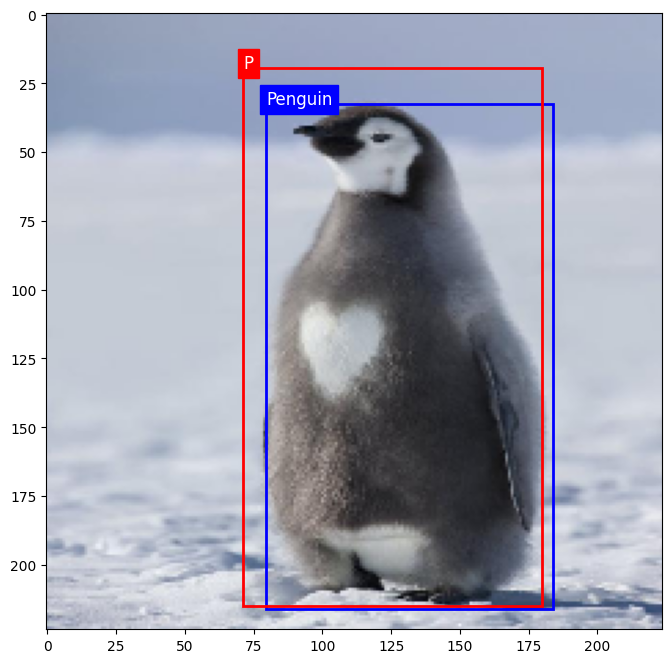

(73.85000133514404, 69.29999732971191, 223.65000534057617, 159.9500026702881)
(76.44340515136719, 56.38315963745117, 205.6912498474121, 150.84625625610352)


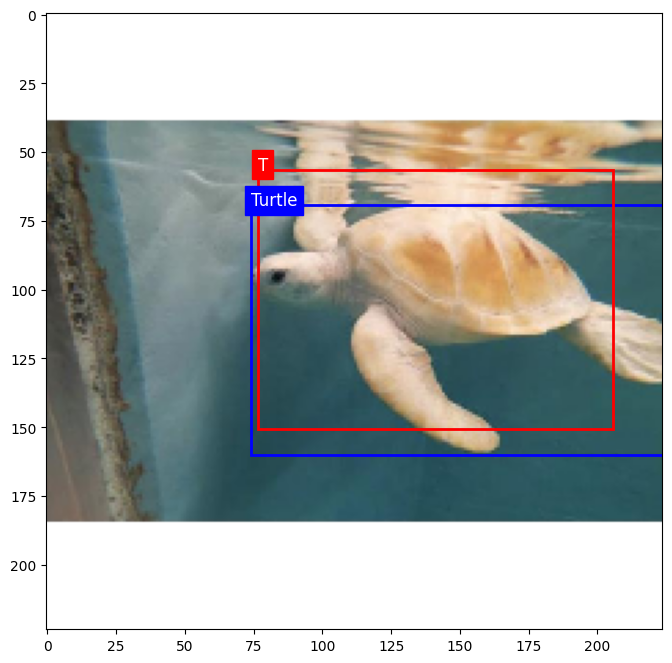

(0.0, 85.04999732971191, 179.2000026702881, 178.5)
(20.29117703437805, 58.23398971557617, 200.7480525970459, 165.6525764465332)


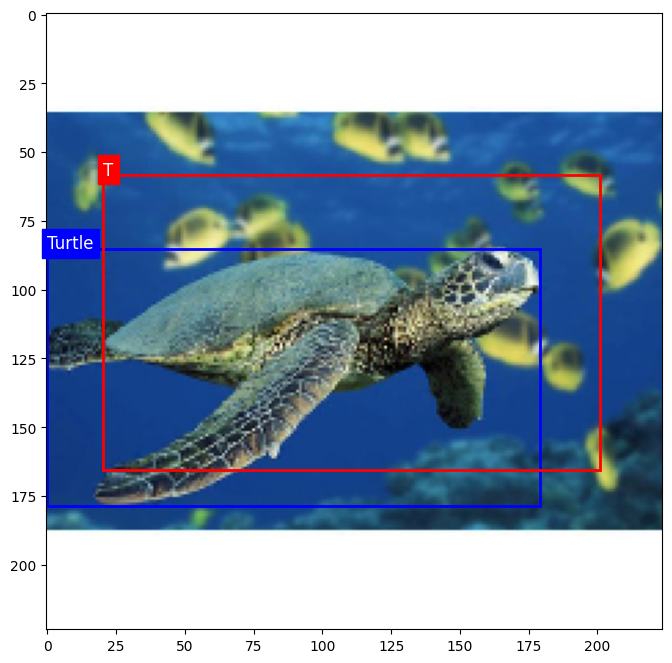

(44.80000066757202, 62.299997329711914, 204.75, 186.2000026702881)
(46.47979211807251, 66.96757411956787, 199.49512672424316, 174.1395263671875)


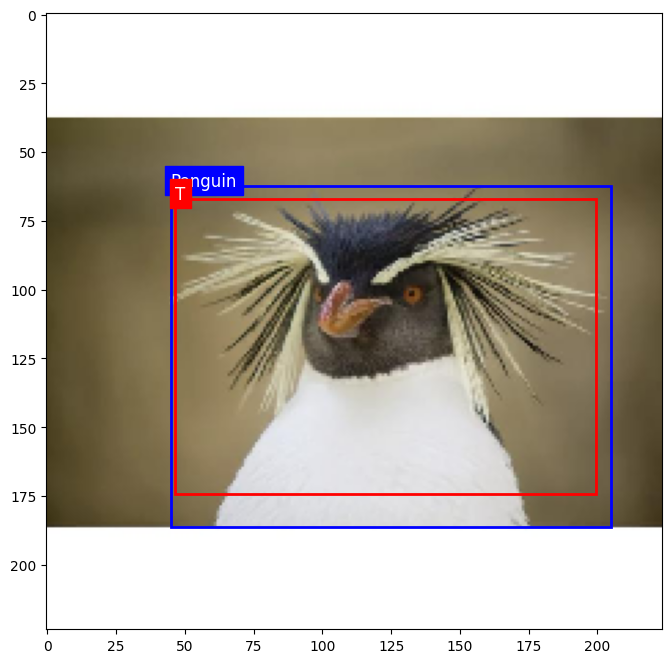

(58.799997329711914, 45.85000133514404, 162.40000534057617, 210.0)
(67.85218715667725, 50.85912466049194, 163.9891872406006, 194.45072555541992)


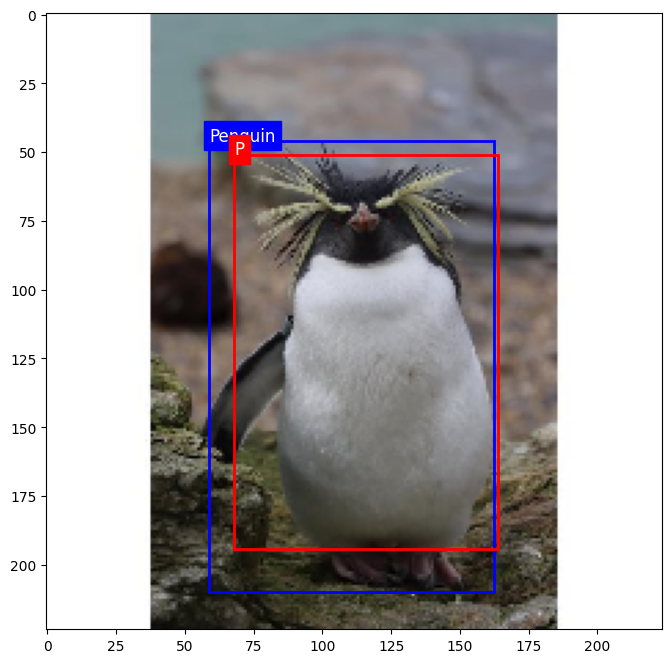

(2.1000000834465027, 42.35000133514404, 157.84999465942383, 207.2000026702881)
(16.623748302459717, 36.225168228149414, 154.22741508483887, 201.72898292541504)


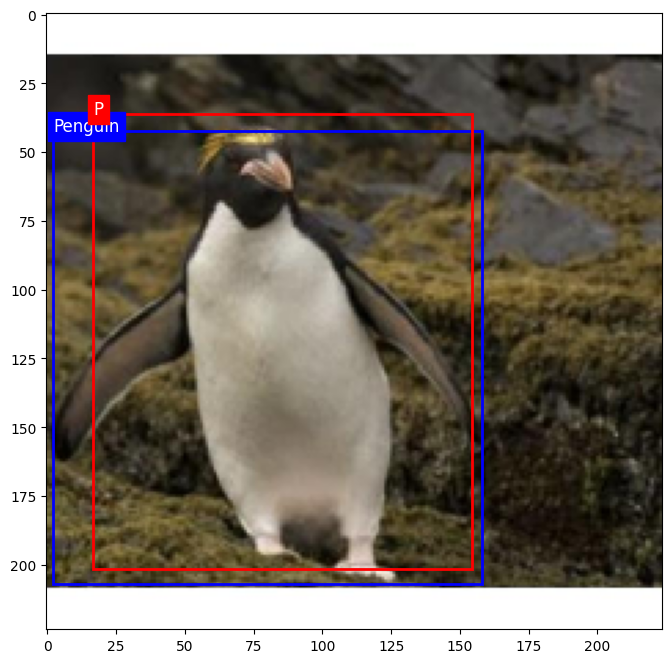

(22.05000066757202, 56.35000133514404, 175.34999465942383, 169.0499973297119)
(32.36239957809448, 58.68362617492676, 195.4669704437256, 170.11255836486816)


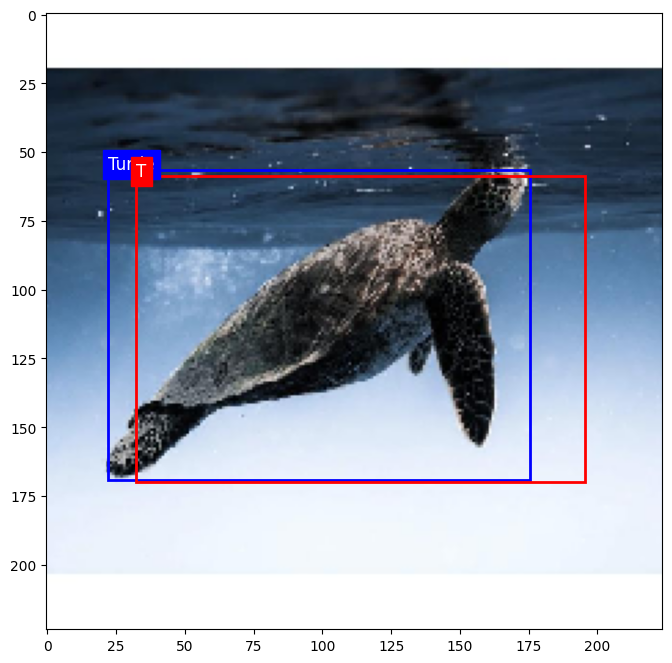

(65.79999732971191, 88.20000267028809, 154.7000026702881, 184.7999973297119)
(82.44965076446533, 92.3271131515503, 133.1599636077881, 189.25578689575195)


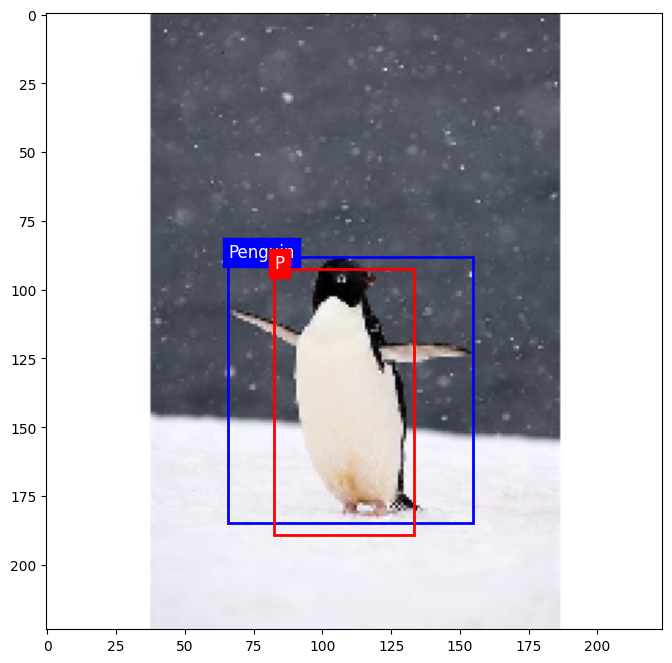

(131.25, 82.95000267028809, 197.40000534057617, 193.2000026702881)
(85.6927490234375, 51.93767738342285, 205.13568305969238, 192.88506889343262)


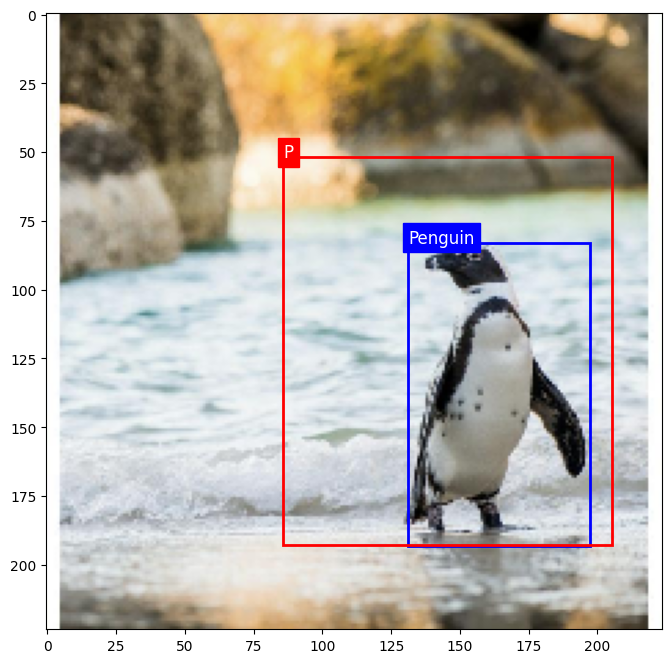

(127.40000534057617, 78.04999732971191, 176.75, 164.15000534057617)
(122.0731143951416, 94.13248825073242, 173.10537719726562, 156.41117668151855)


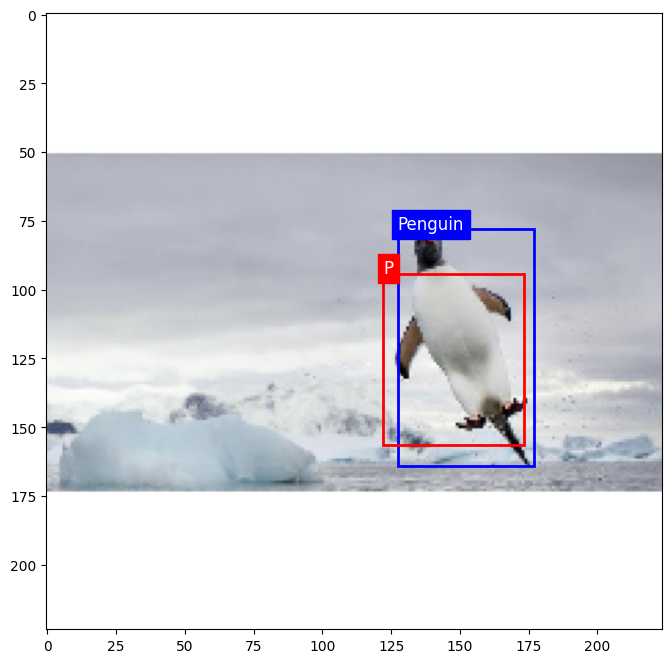

(54.25, 60.549997329711914, 224.0, 186.5499973297119)
(53.53849172592163, 69.30180644989014, 205.63839149475098, 174.29533767700195)


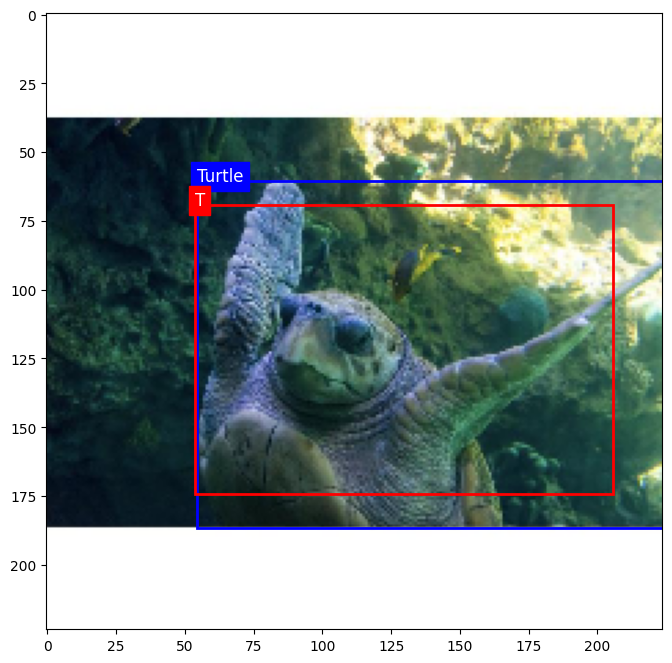

(46.55000066757202, 94.85000133514404, 169.40000534057617, 135.4500026702881)
(49.54180145263672, 95.53677272796631, 148.1640453338623, 142.1497688293457)


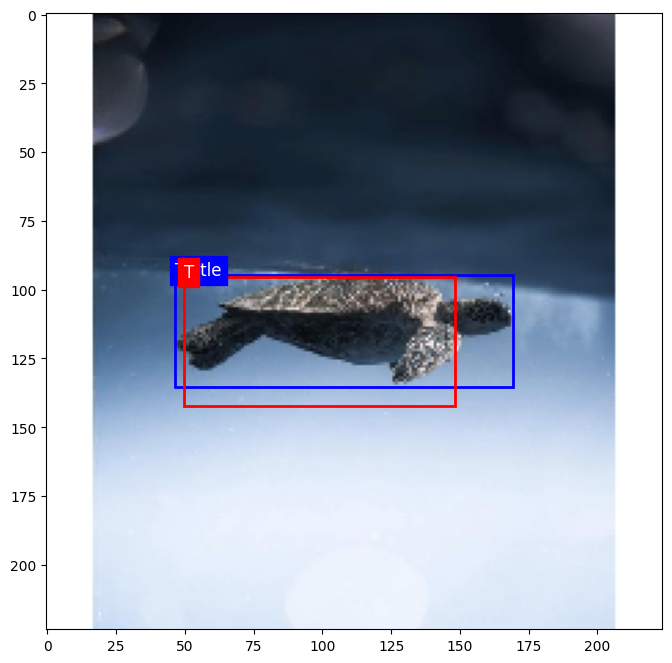

(49.35000133514404, 13.65000033378601, 224.0, 147.34999465942383)
(38.69462728500366, 9.763069748878479, 218.2957305908203, 130.56844902038574)


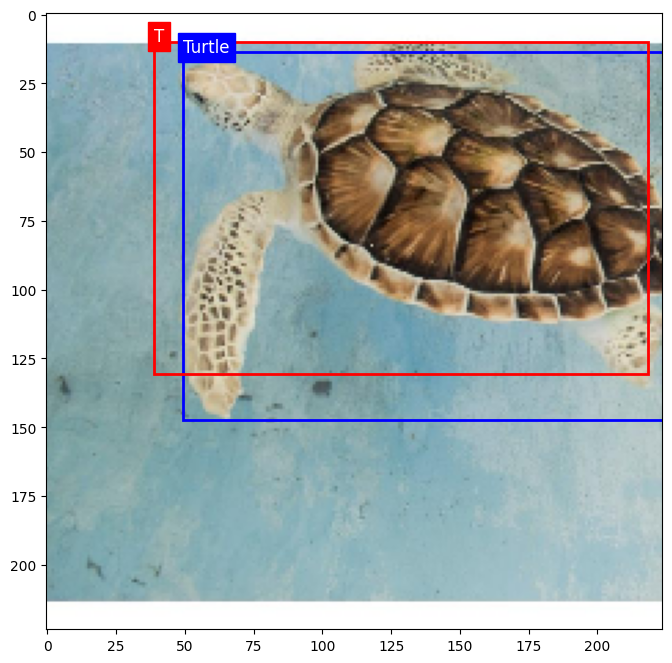

(44.10000133514404, 144.90000534057617, 181.65000534057617, 197.75)
(56.55554676055908, 70.52432441711426, 176.07428359985352, 189.38171768188477)


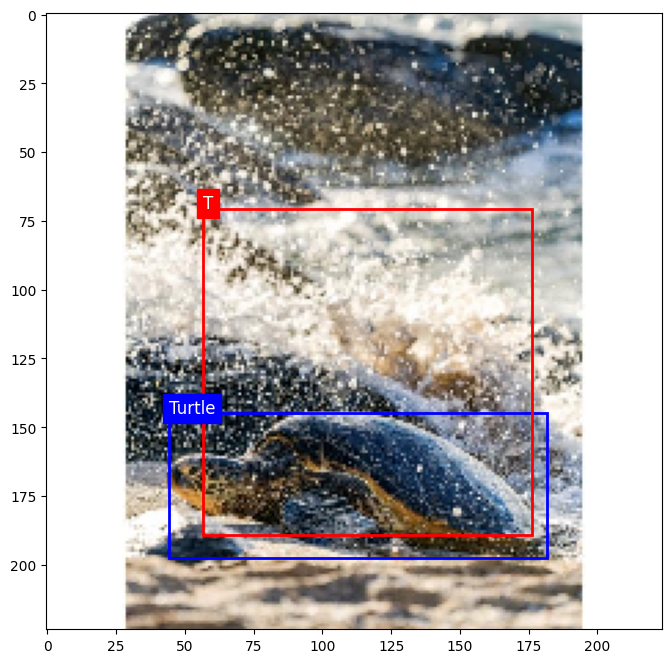

(62.299997329711914, 41.64999866485596, 162.40000534057617, 210.7000026702881)
(47.68533372879028, 34.61923360824585, 172.32624053955078, 201.2574234008789)


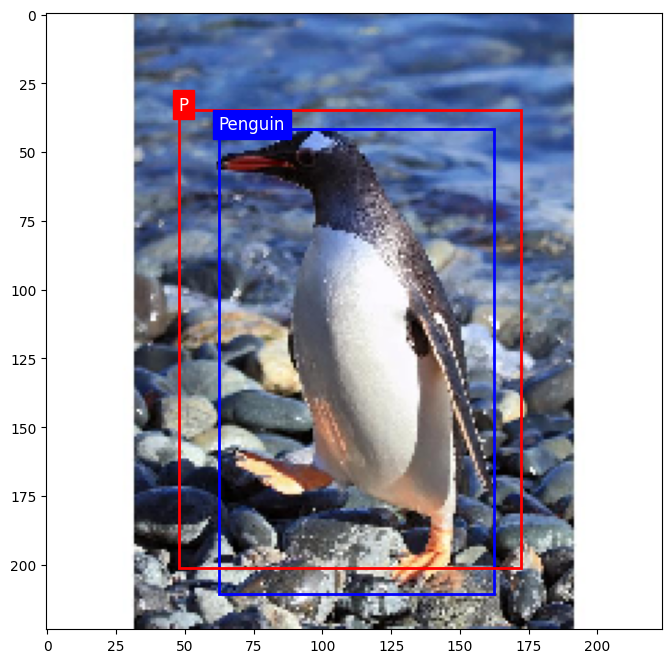

(127.04999732971191, 65.45000267028809, 216.2999973297119, 142.09999465942383)
(120.11065292358398, 66.70018482208252, 192.51494026184082, 162.1122283935547)


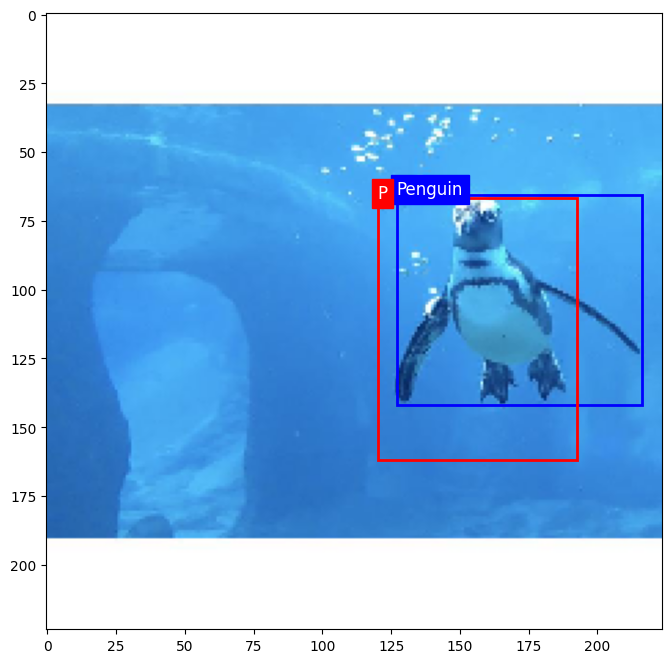

(36.05000066757202, 58.450002670288086, 209.65000534057617, 151.5499973297119)
(37.16406488418579, 45.57941436767578, 205.53167343139648, 156.79880905151367)


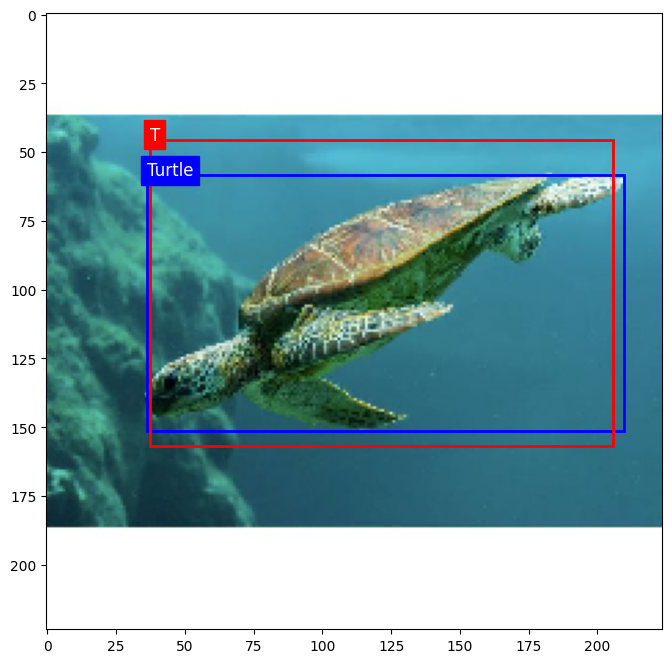

(21.0, 58.450002670288086, 191.09999465942383, 224.0)
(43.76669263839722, 37.9224967956543, 178.27294540405273, 216.28430938720703)


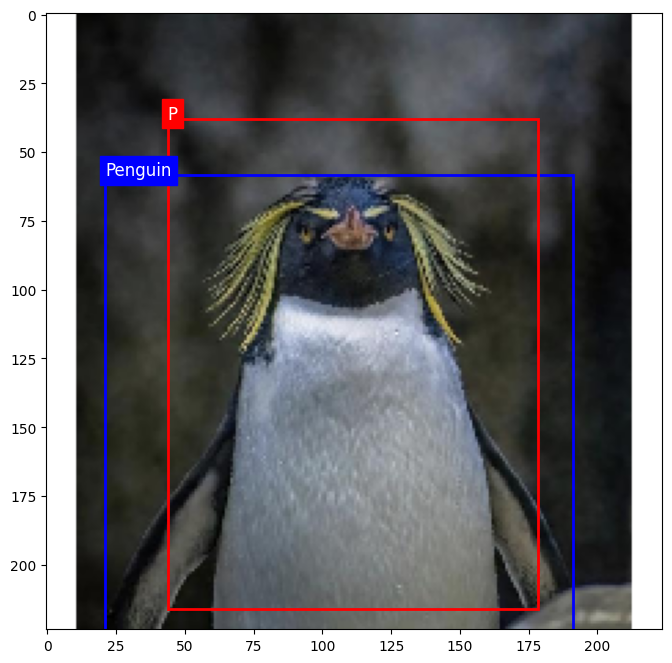

(57.39999866485596, 99.39999866485596, 112.0, 124.95000267028809)
(60.555938720703125, 64.56048965454102, 165.24059104919434, 154.19175338745117)


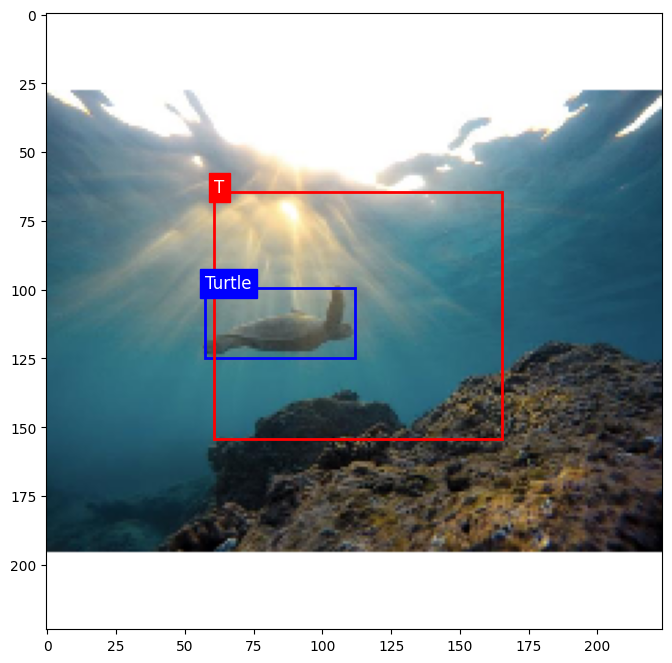

(39.89999866485596, 71.75, 218.75, 149.7999973297119)
(34.631770610809326, 56.10719871520996, 215.0718116760254, 147.3047866821289)


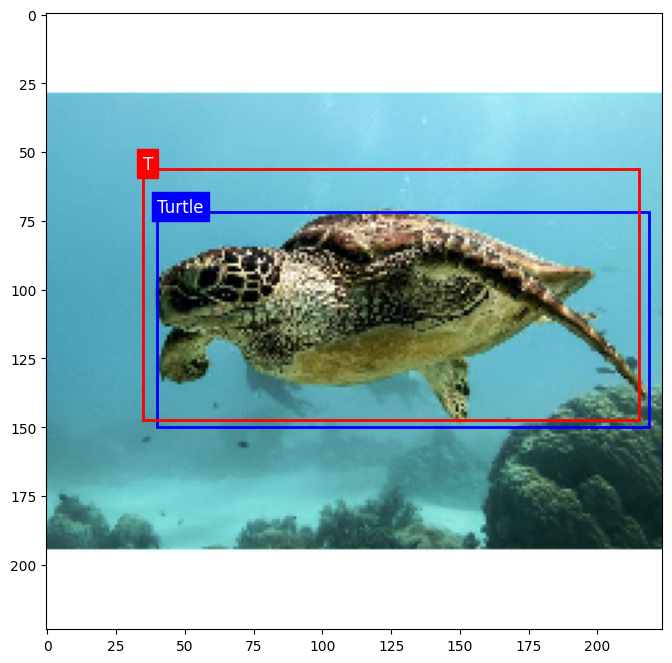

(47.94999933242798, 38.85000133514404, 186.5499973297119, 180.59999465942383)
(62.416181564331055, 39.8263521194458, 208.8177032470703, 183.79152297973633)


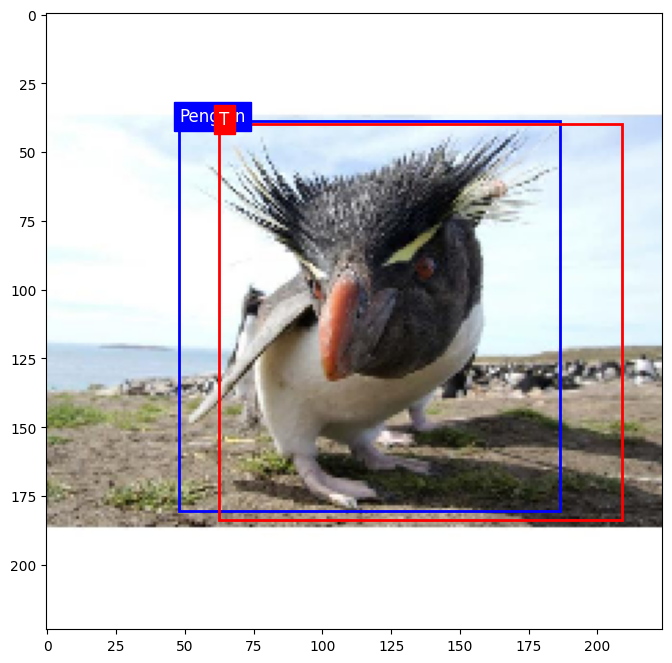

(55.64999866485596, 112.34999465942383, 154.7000026702881, 191.7999973297119)
(26.801936864852905, 78.90104484558105, 168.94608306884766, 209.22050285339355)


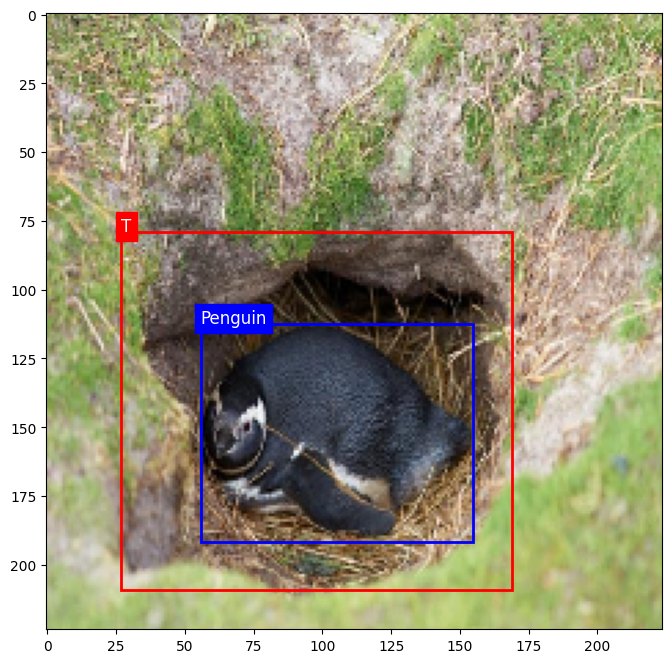

(0.0, 79.79999732971191, 144.90000534057617, 152.59999465942383)
(38.361929416656494, 73.03840065002441, 126.34552192687988, 145.24272346496582)


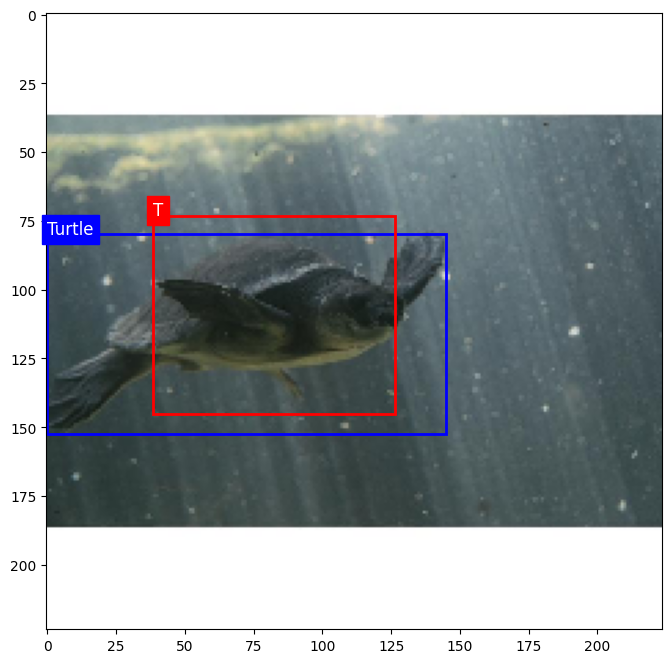

(54.60000133514404, 86.79999732971191, 179.90000534057617, 186.5499973297119)
(69.58436965942383, 81.94843101501465, 203.54455184936523, 189.8199920654297)


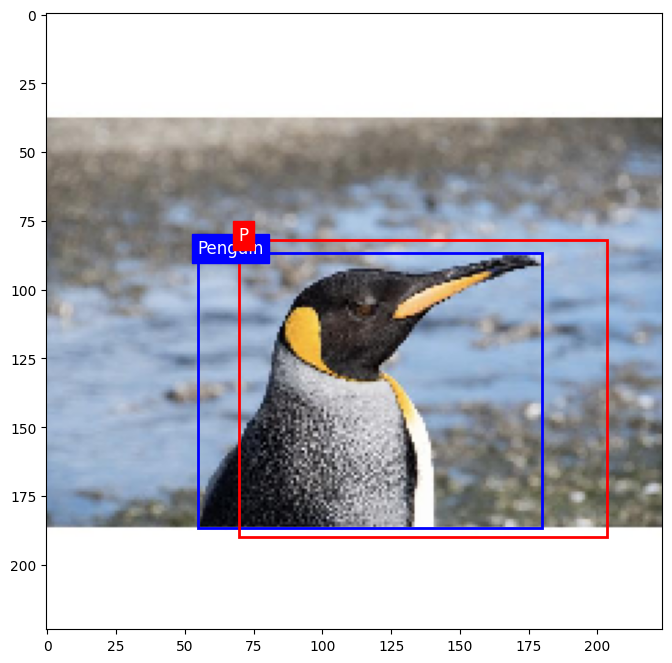

(15.050000667572021, 48.30000066757202, 105.35000133514404, 184.09999465942383)
(11.009920716285706, 42.779380321502686, 82.46666717529297, 189.32513427734375)


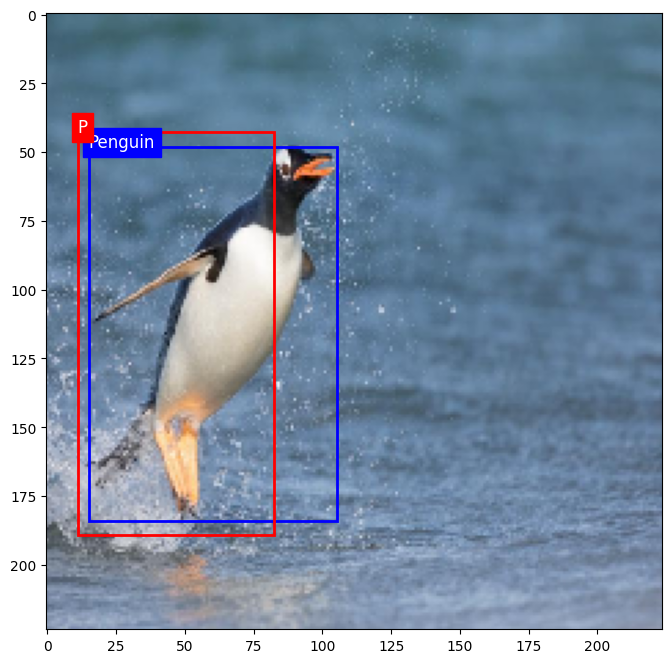

(12.25, 73.14999866485596, 223.65000534057617, 144.2000026702881)
(18.514285564422607, 77.45450973510742, 206.49906539916992, 154.3214225769043)


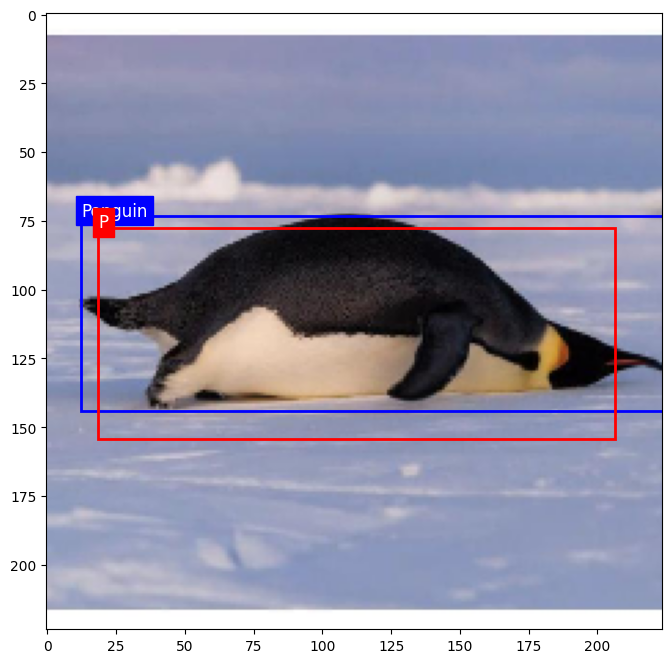

(1.4000000208616257, 59.14999866485596, 171.5, 181.65000534057617)
(19.72650456428528, 44.813899517059326, 206.03030967712402, 179.4557762145996)


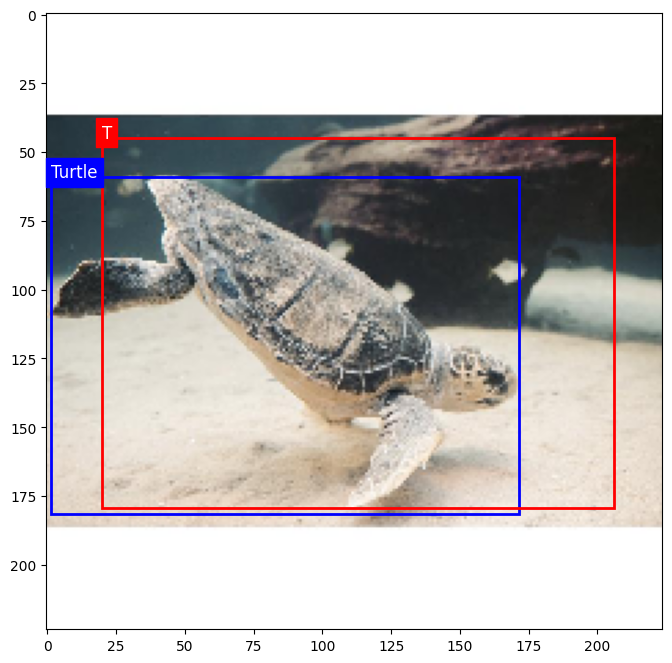

(88.20000267028809, 58.799997329711914, 224.0, 135.09999465942383)
(90.74737739562988, 65.41297912597656, 214.77496910095215, 131.7822551727295)


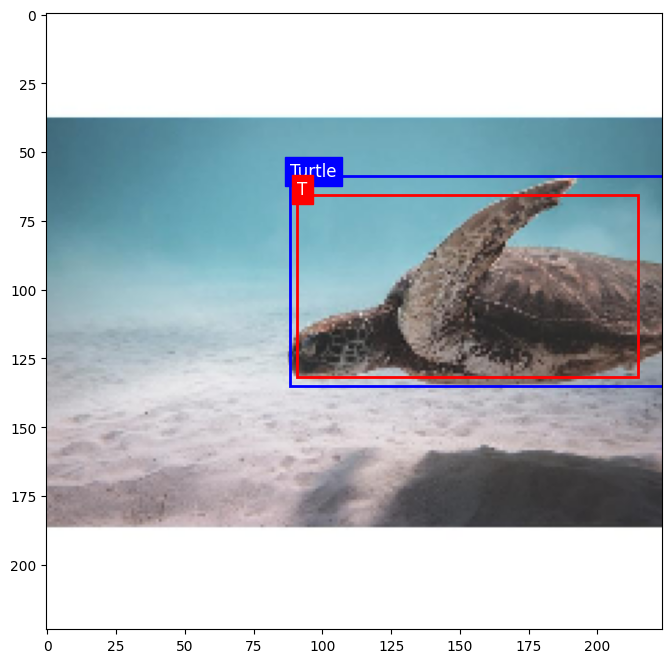

(78.04999732971191, 89.60000133514404, 159.59999465942383, 130.2000026702881)
(76.85814762115479, 77.60486698150635, 148.2902431488037, 111.05346298217773)


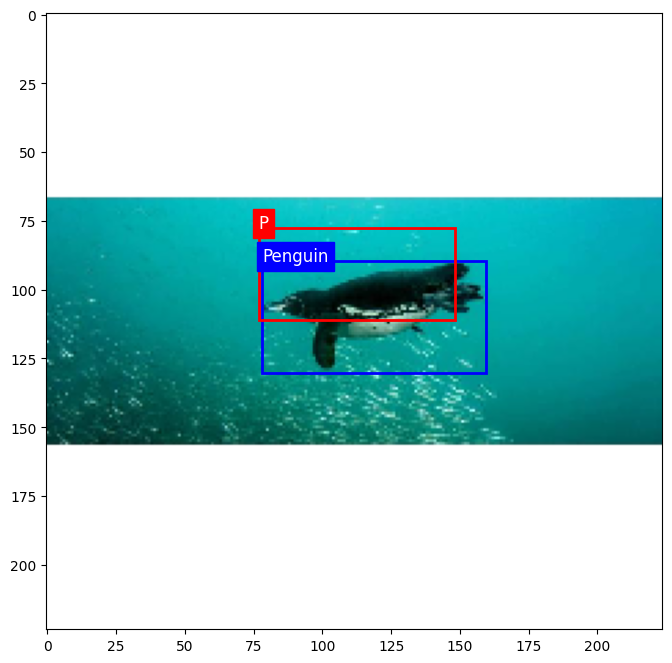

(67.54999732971191, 80.85000133514404, 193.2000026702881, 158.90000534057617)
(75.79027271270752, 93.86116027832031, 159.66221237182617, 150.18394470214844)


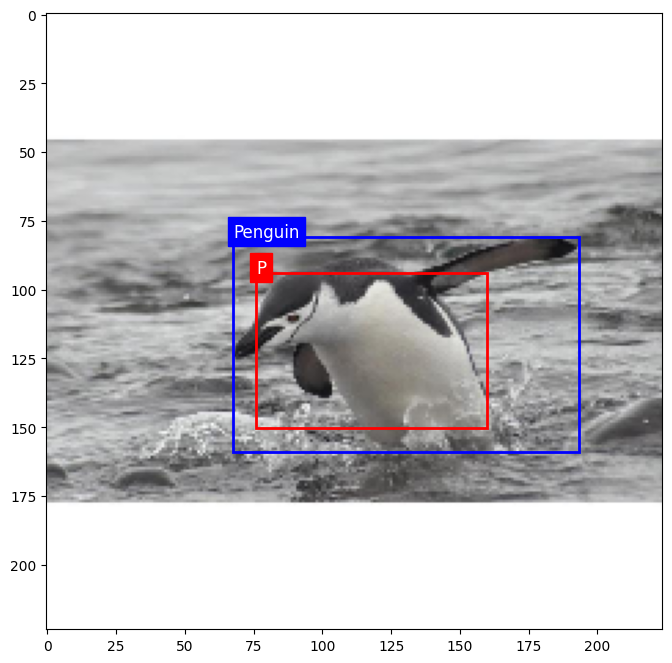

(21.34999966621399, 44.44999933242798, 179.90000534057617, 203.0)
(26.385039806365967, 57.09822940826416, 199.3422393798828, 172.2155704498291)


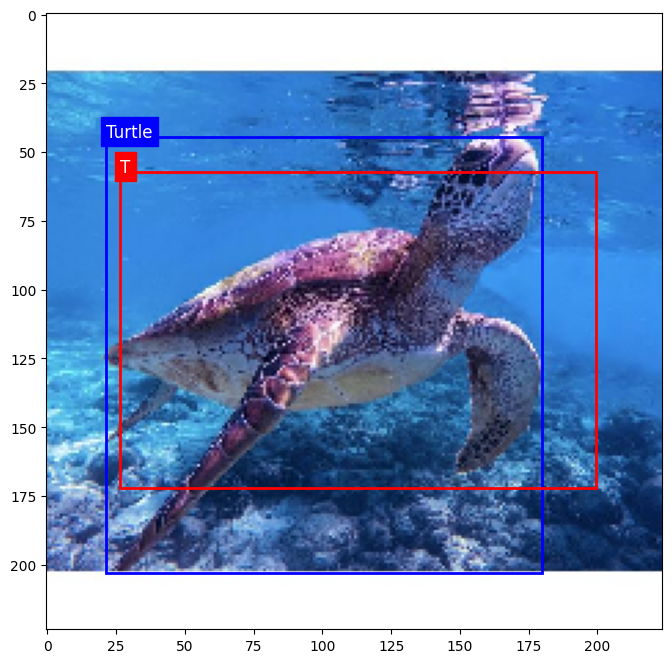

(59.85000133514404, 103.95000267028809, 162.40000534057617, 154.0)
(67.42455387115479, 112.18764114379883, 152.95323371887207, 174.25162506103516)


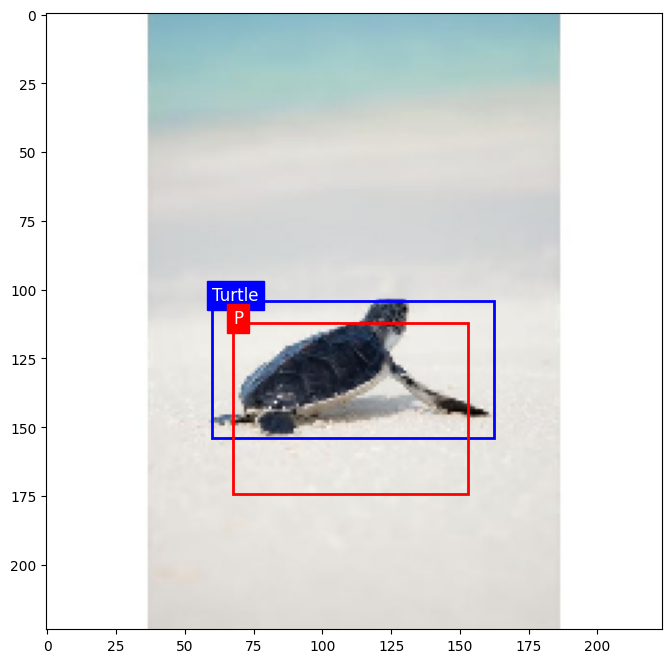

(26.59999966621399, 62.64999866485596, 168.7000026702881, 186.90000534057617)
(23.27943468093872, 44.71671438217163, 170.55491828918457, 189.2117404937744)


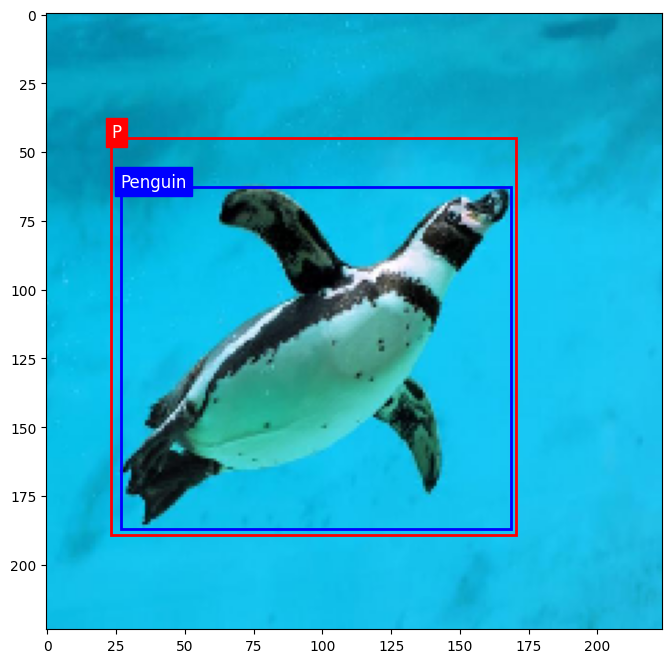

(26.25, 107.10000133514404, 148.0499973297119, 157.5)
(40.89096260070801, 99.17467975616455, 149.46119117736816, 163.3751277923584)


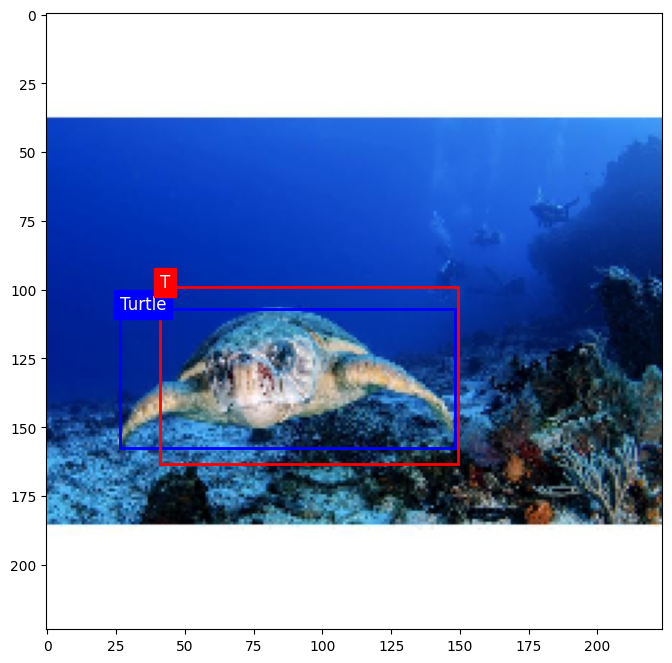

(80.85000133514404, 116.54999732971191, 121.09999465942383, 138.59999465942383)
(79.48592472076416, 115.29374694824219, 123.35773658752441, 130.2900447845459)


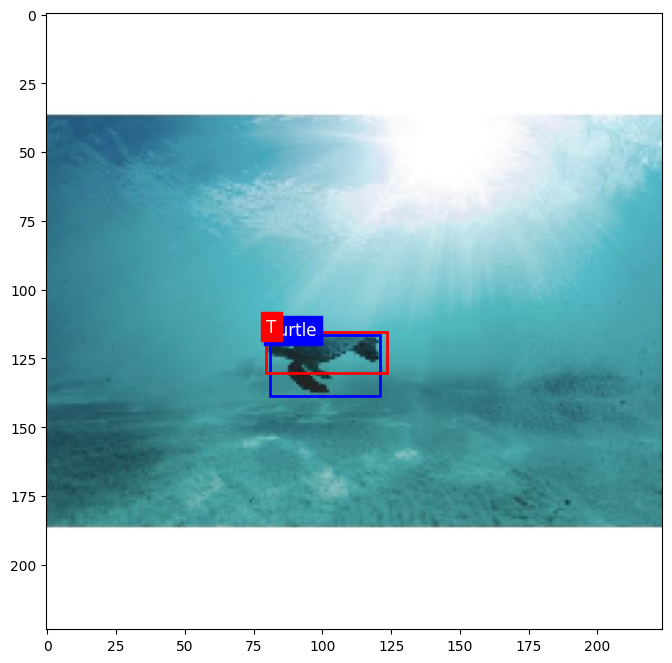

(54.25, 56.35000133514404, 171.15000534057617, 170.09999465942383)
(31.856396675109863, 47.93862056732178, 178.89554977416992, 178.06012344360352)


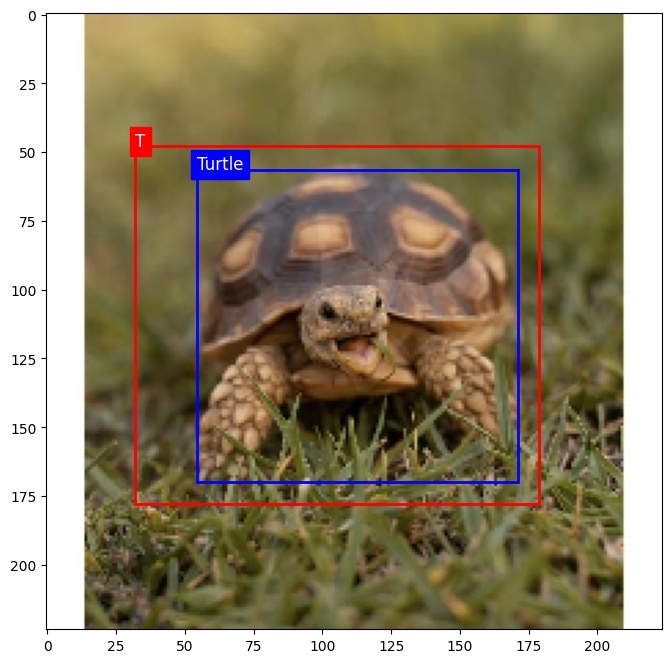

(19.59999966621399, 65.10000133514404, 209.65000534057617, 161.0)
(16.542065858840942, 51.68207406997681, 211.53334617614746, 157.2757225036621)


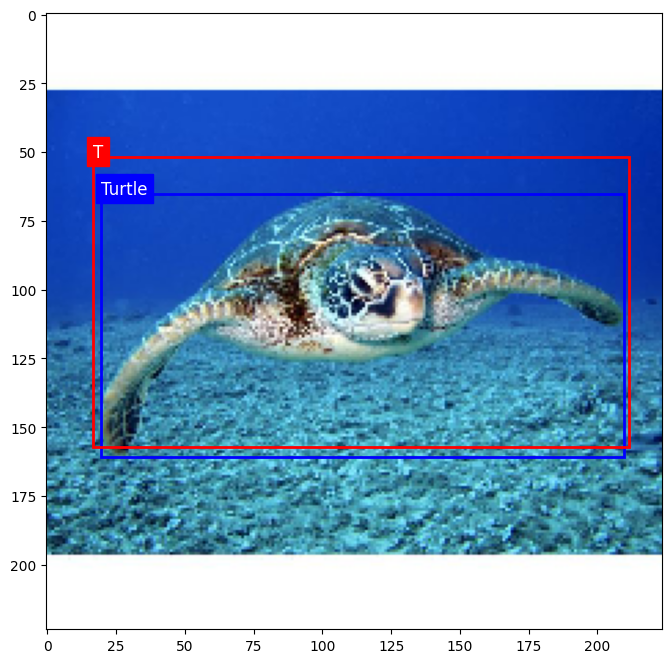

(90.29999732971191, 102.89999866485596, 123.20000267028809, 163.7999973297119)
(75.85566806793213, 96.6738748550415, 129.12999153137207, 169.79829216003418)


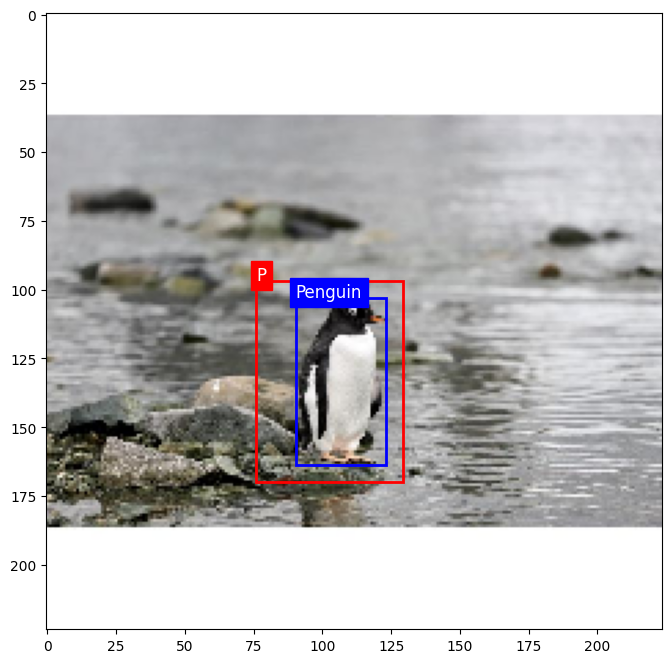

(67.54999732971191, 53.19999933242798, 117.25, 180.25)
(46.87040853500366, 45.10480737686157, 174.74641609191895, 166.06669807434082)


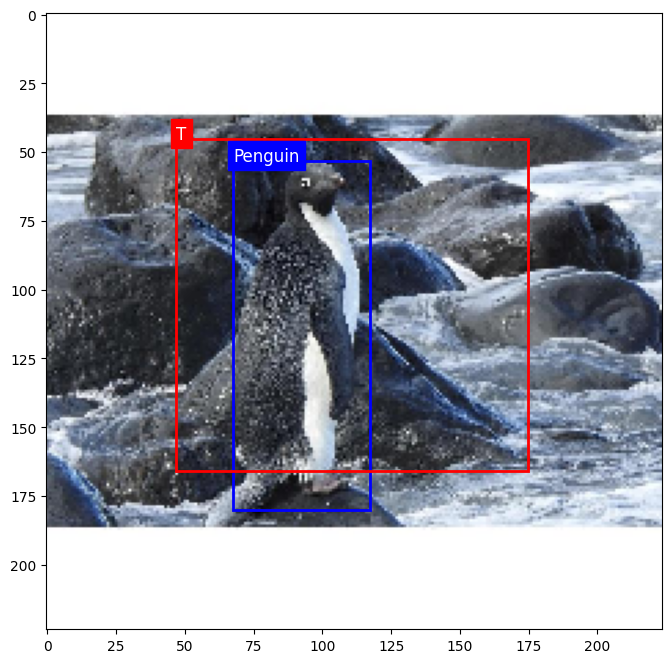

(58.799997329711914, 63.0, 224.0, 144.90000534057617)
(63.08725166320801, 70.31106853485107, 188.55032348632812, 164.57486152648926)


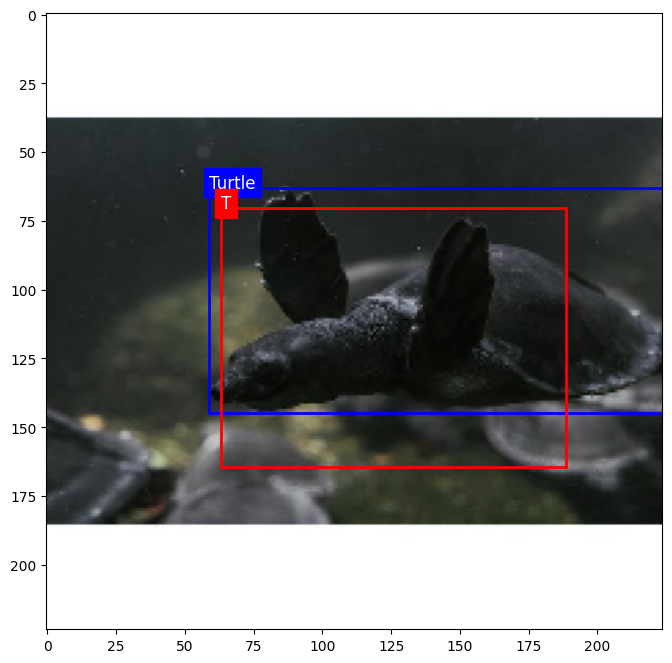

(32.89999866485596, 87.85000133514404, 175.0, 200.5499973297119)
(45.15437459945679, 82.11879539489746, 164.18944549560547, 175.7462921142578)


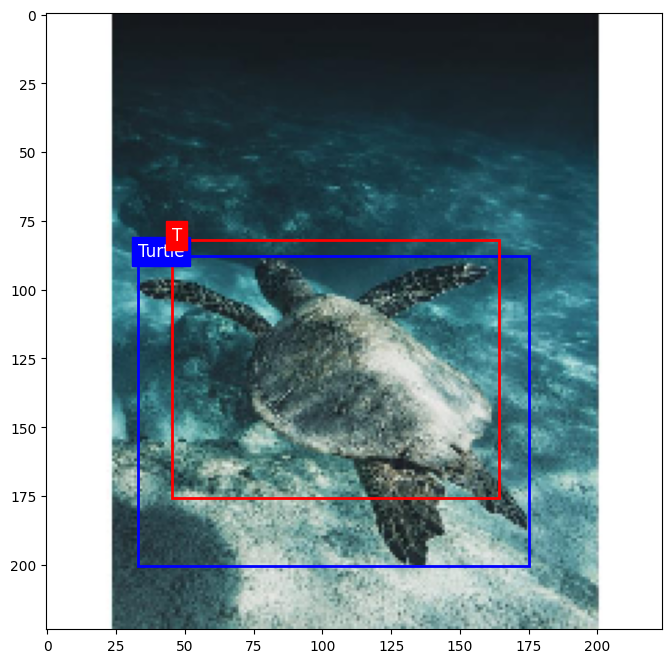

(81.20000267028809, 80.5, 204.75, 141.75)
(87.81153583526611, 89.45732116699219, 204.86336708068848, 139.67669486999512)


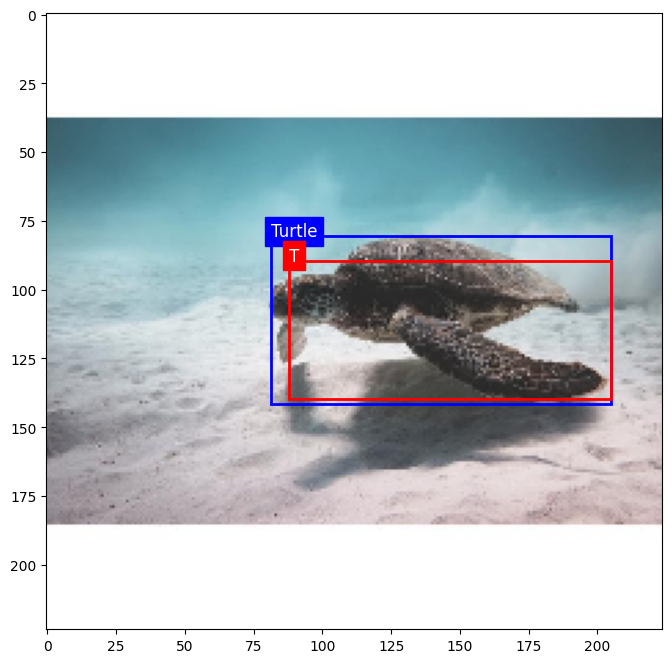

(110.60000133514404, 88.20000267028809, 182.0, 178.15000534057617)
(122.39863586425781, 86.90226936340332, 191.5276279449463, 171.97417640686035)


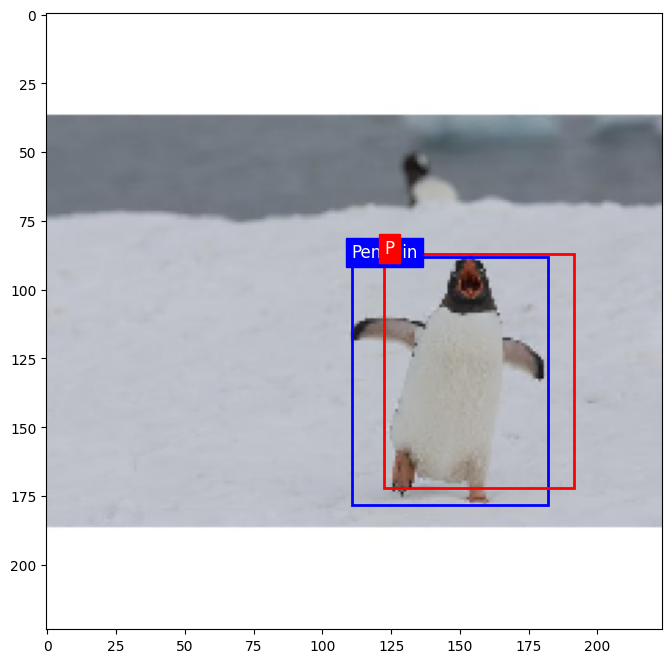

(34.64999866485596, 28.350001335144043, 203.7000026702881, 196.34999465942383)
(40.991332054138184, 51.48938274383545, 177.5821418762207, 185.85246467590332)


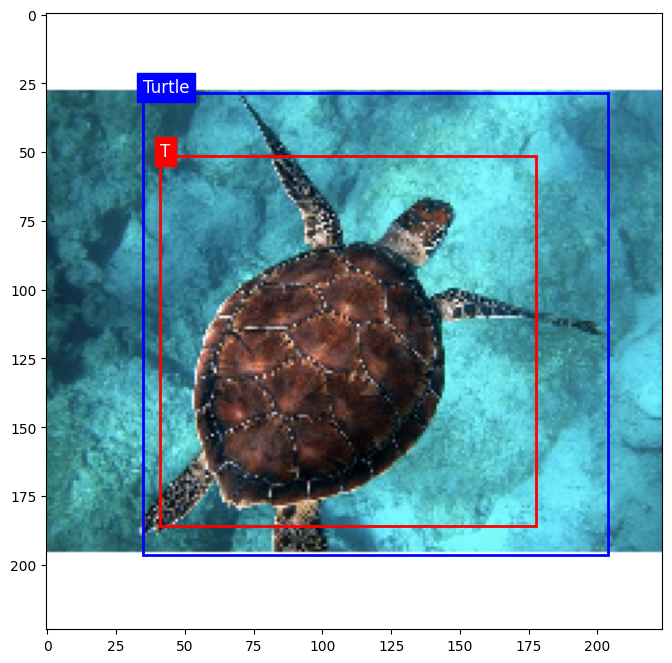

(88.20000267028809, 75.25, 183.40000534057617, 134.40000534057617)
(82.44842910766602, 80.0928144454956, 179.5031337738037, 137.34843063354492)


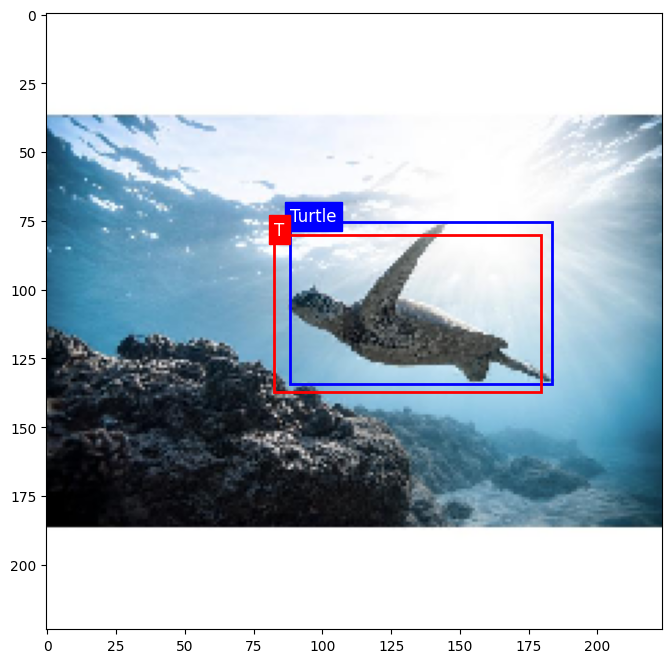

(61.950002670288086, 71.39999866485596, 161.34999465942383, 142.09999465942383)
(75.88098907470703, 83.44793128967285, 154.109468460083, 159.50151443481445)


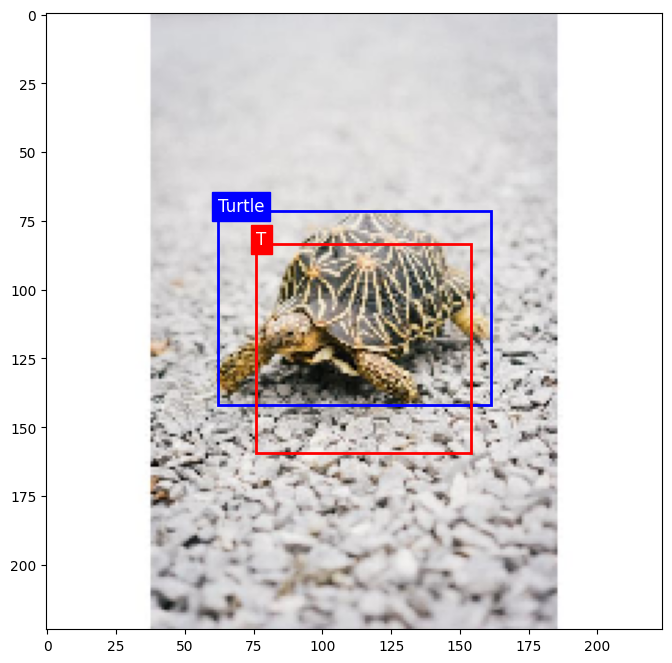

(45.5, 53.89999866485596, 142.09999465942383, 159.9500026702881)
(45.22932958602905, 57.290536880493164, 144.51879501342773, 158.97351837158203)


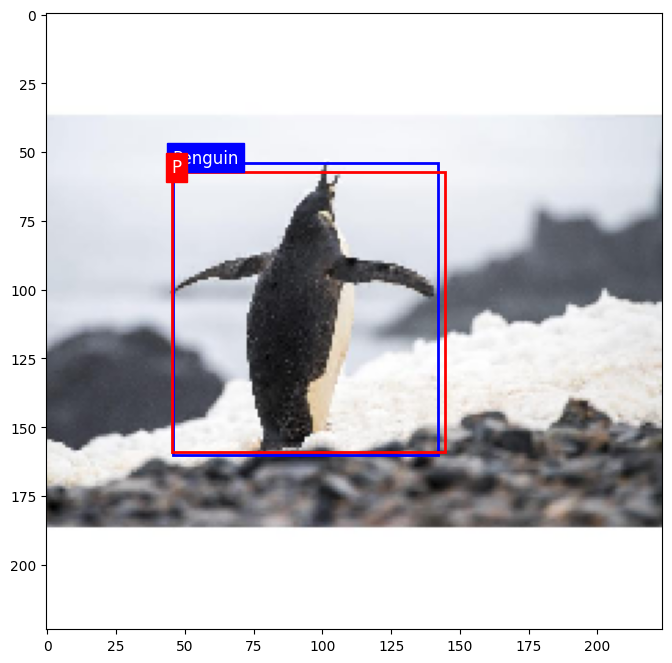

(69.64999866485596, 69.64999866485596, 151.5499973297119, 151.2000026702881)
(79.75757312774658, 85.18092155456543, 137.9300994873047, 135.87011909484863)


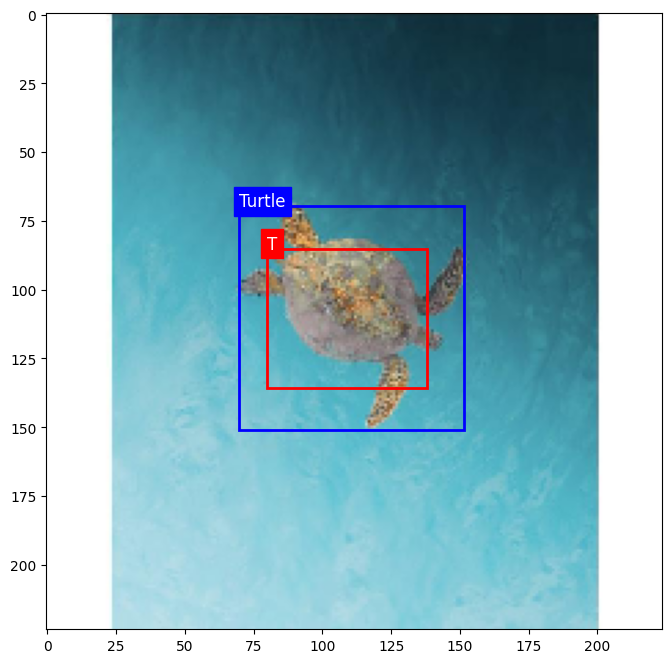

(79.79999732971191, 59.5, 201.25, 194.9500026702881)
(110.6852035522461, 61.05490207672119, 193.27905654907227, 186.72550201416016)


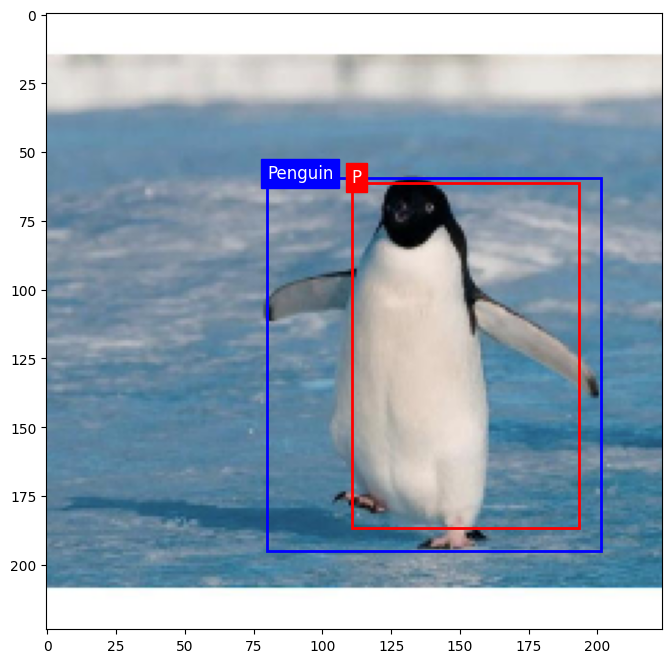

(84.0, 64.39999866485596, 138.59999465942383, 138.9500026702881)
(34.47566223144531, 62.43264389038086, 151.49290657043457, 157.70429039001465)


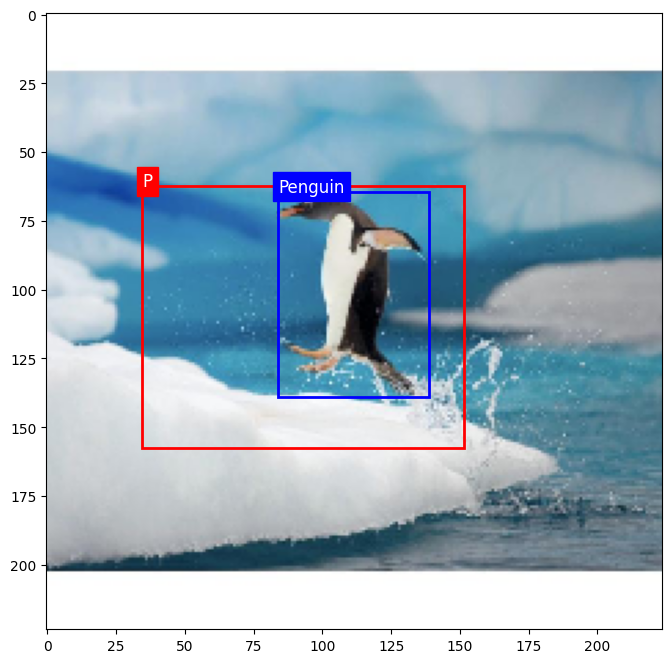

(0.3500000052154064, 80.14999866485596, 204.40000534057617, 179.90000534057617)
(24.885644674301147, 62.40413856506348, 186.80136489868164, 158.95031356811523)


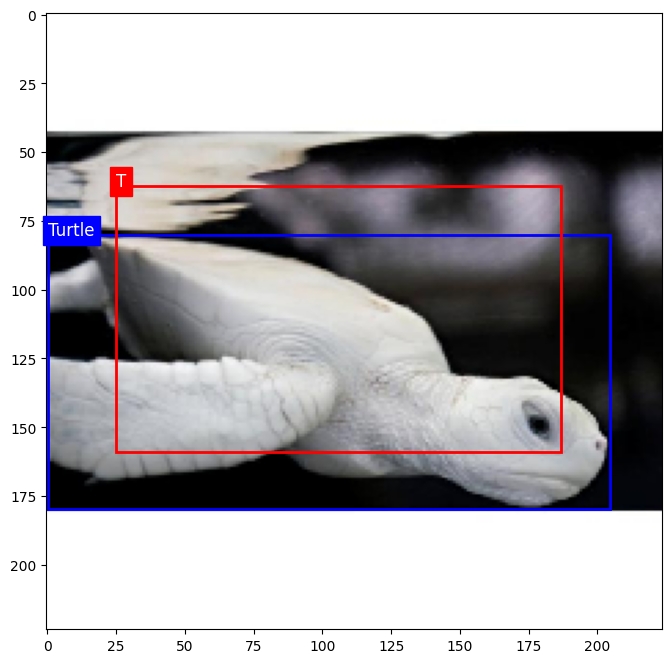

(33.94999933242798, 44.80000066757202, 164.15000534057617, 186.5499973297119)
(40.972196102142334, 42.925772190093994, 171.09905624389648, 165.5142822265625)


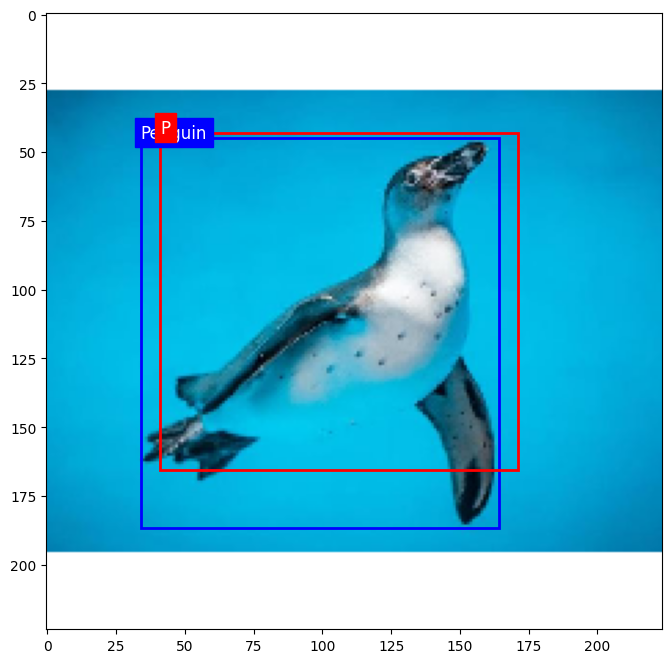

(60.89999866485596, 85.75, 144.2000026702881, 131.9500026702881)
(62.20437431335449, 82.956711769104, 141.69598007202148, 136.23788452148438)


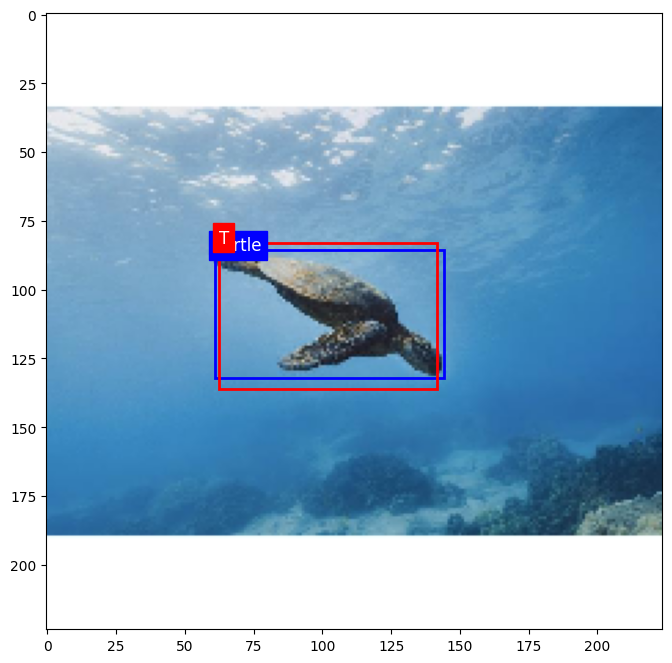

(48.64999866485596, 67.20000267028809, 125.65000534057617, 148.40000534057617)
(44.57071304321289, 56.353492736816406, 126.16363525390625, 183.3176670074463)


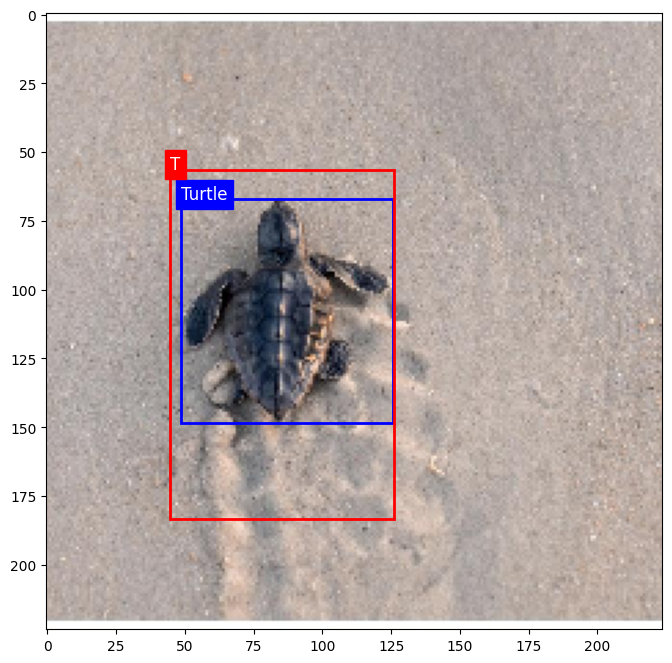

(78.39999866485596, 86.10000133514404, 157.15000534057617, 163.7999973297119)
(106.5786542892456, 93.95689010620117, 143.70877647399902, 164.33577728271484)


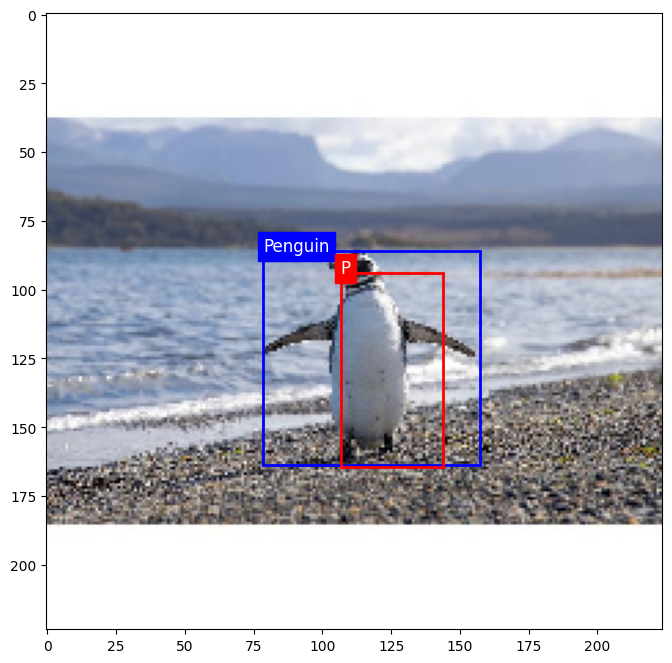

(59.14999866485596, 16.80000066757202, 184.4500026702881, 205.4500026702881)
(61.021196365356445, 23.152727842330933, 188.07351684570312, 208.20495223999023)


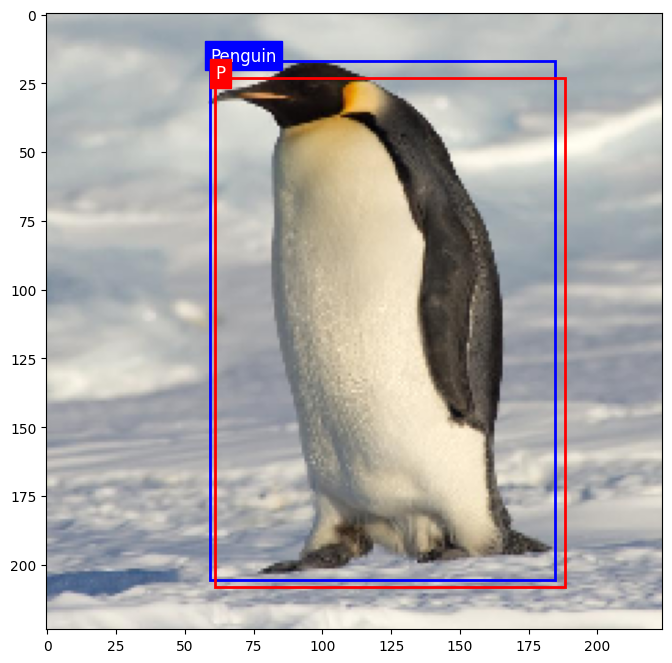

(62.299997329711914, 87.85000133514404, 84.0, 133.7000026702881)
(47.86482048034668, 96.59101581573486, 122.67356872558594, 147.3592472076416)


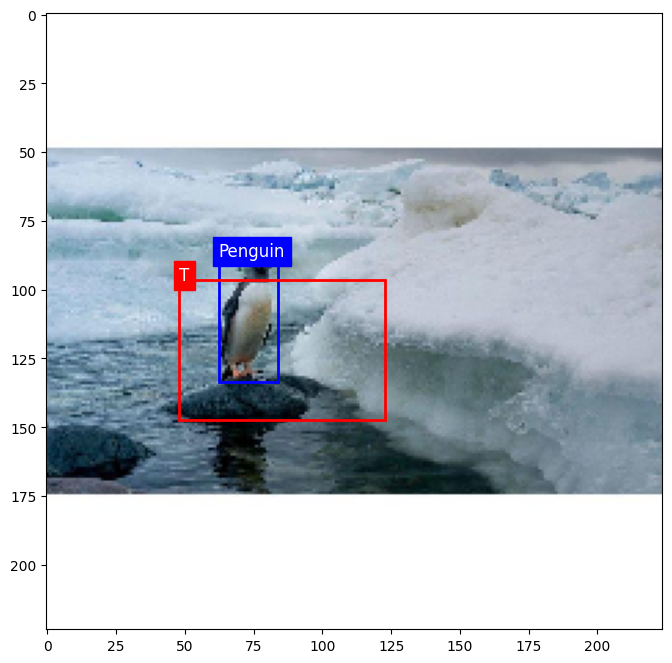

(92.04999732971191, 44.44999933242798, 222.59999465942383, 183.75)
(104.36225509643555, 60.01492500305176, 198.1281795501709, 175.68463516235352)


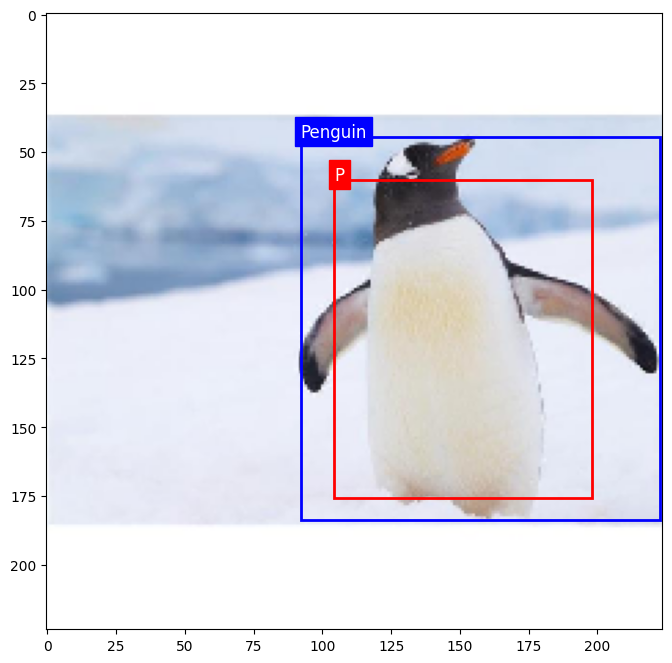

(75.95000267028809, 120.40000534057617, 183.0499973297119, 212.09999465942383)
(79.09755802154541, 116.18876075744629, 177.4893093109131, 204.22387313842773)


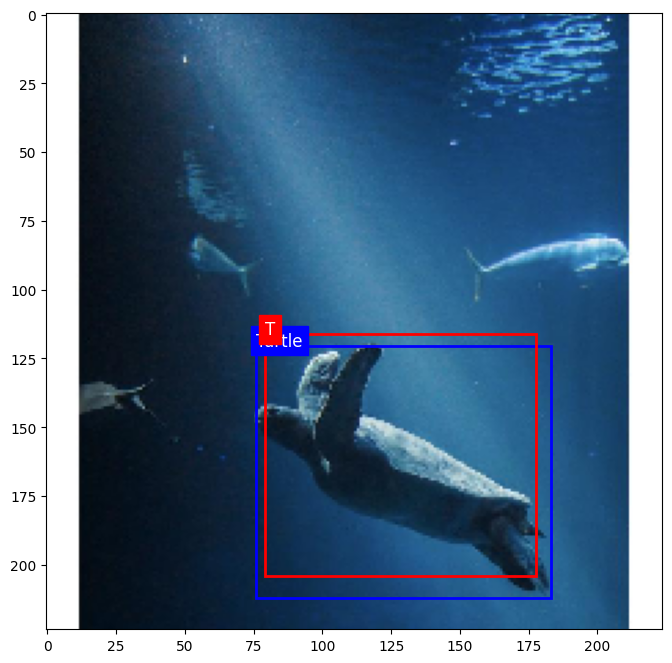

(26.59999966621399, 63.35000133514404, 182.0, 163.09999465942383)
(48.28535747528076, 58.81049156188965, 185.88014221191406, 150.20900535583496)


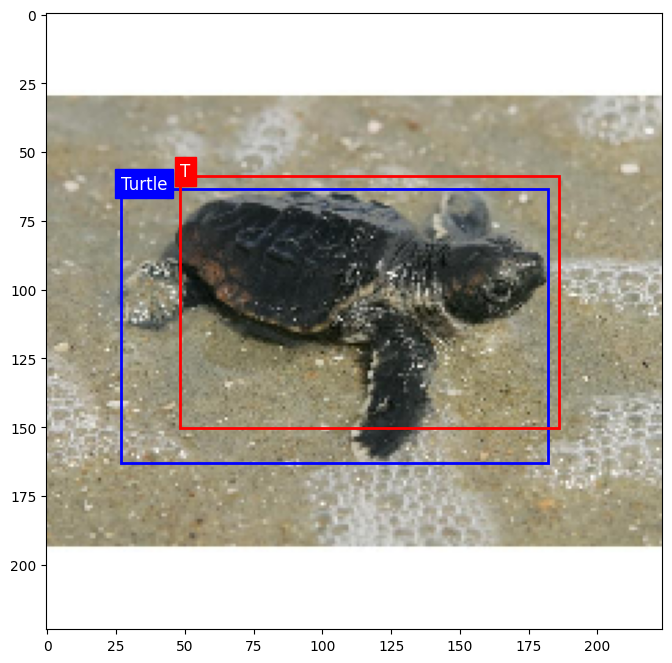

(68.95000267028809, 44.44999933242798, 223.65000534057617, 163.7999973297119)
(58.17663860321045, 46.33977556228638, 208.47053909301758, 153.36392402648926)


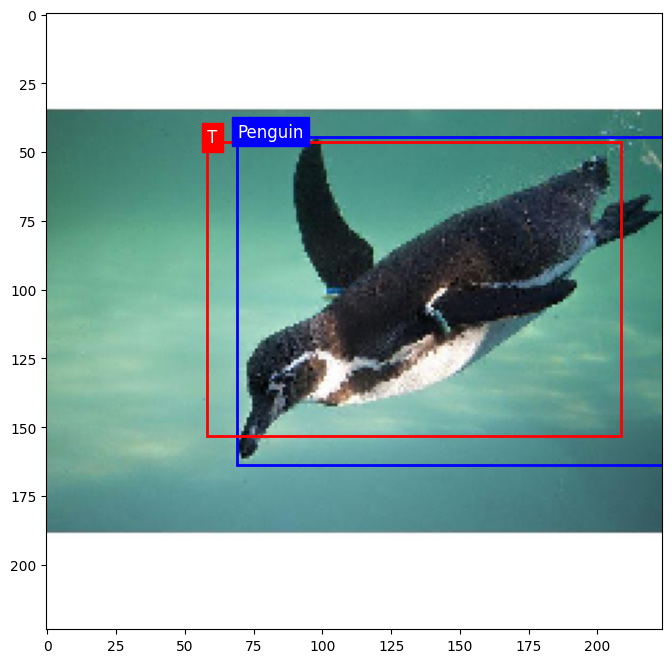

(86.79999732971191, 67.20000267028809, 142.09999465942383, 180.25)
(78.82530879974365, 74.70924663543701, 142.98377990722656, 187.90029525756836)


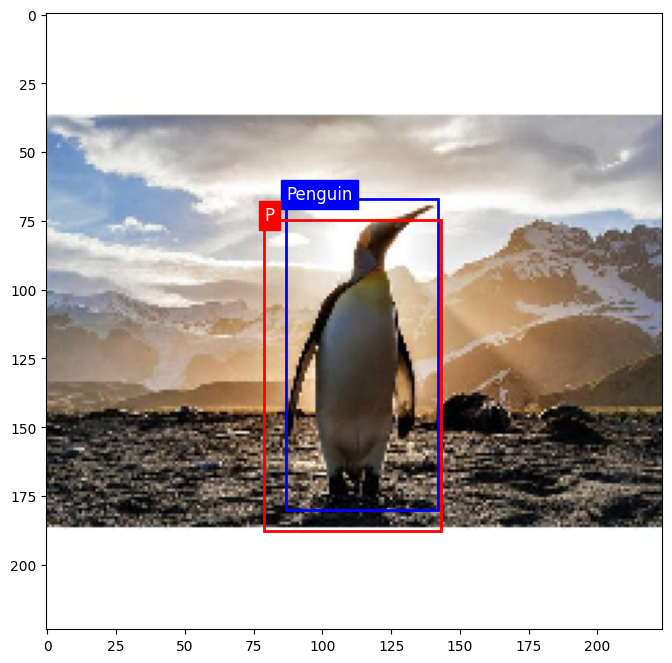

(9.799999833106995, 72.10000133514404, 169.40000534057617, 186.90000534057617)
(35.68187141418457, 62.5726203918457, 185.62382125854492, 176.09846305847168)


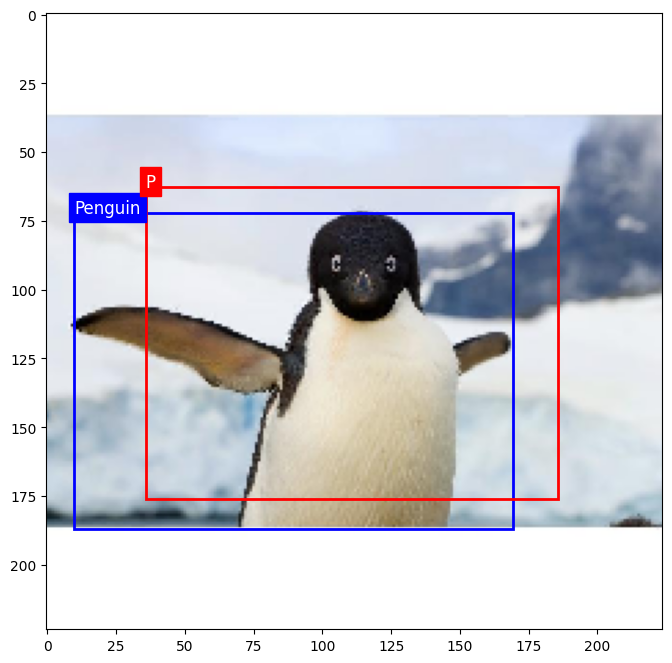

(18.55000066757202, 56.700002670288086, 113.75, 173.9500026702881)
(14.36596131324768, 51.120285511016846, 122.71615982055664, 176.2227382659912)


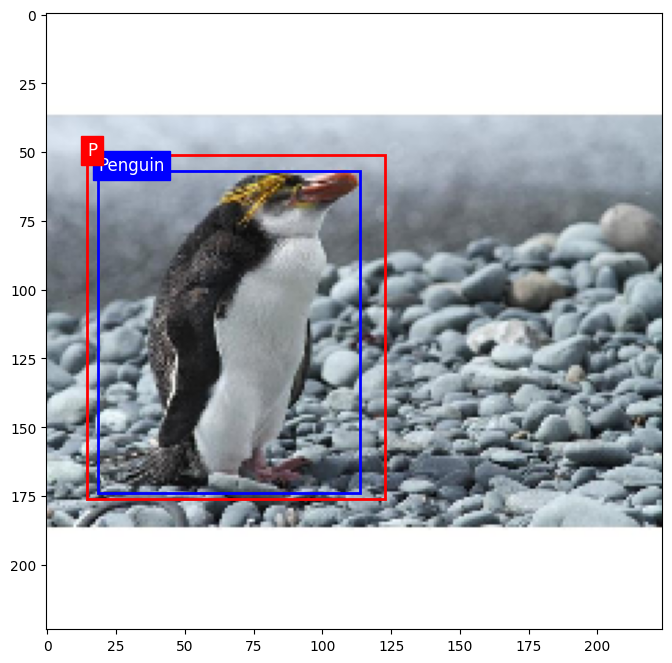

(91.0, 69.29999732971191, 188.65000534057617, 171.15000534057617)
(87.958815574646, 60.21800708770752, 200.06268310546875, 152.9998435974121)


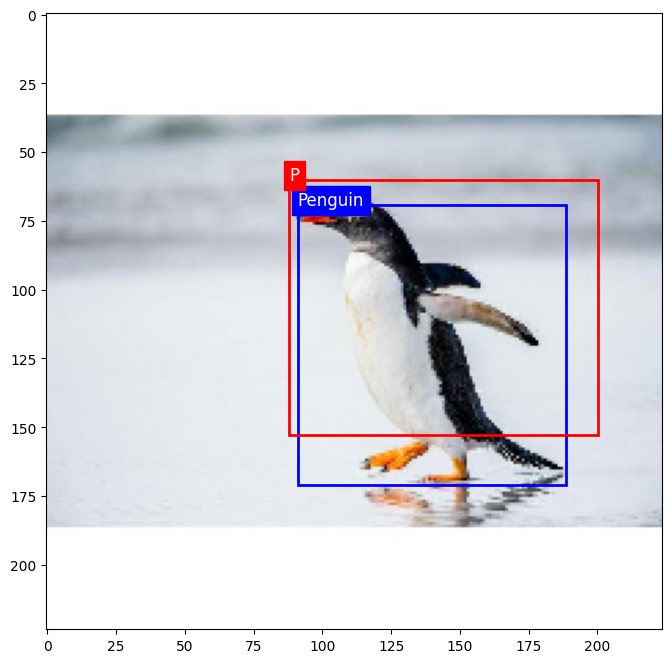

(47.94999933242798, 32.55000066757202, 195.2999973297119, 97.29999732971191)
(51.09264135360718, 28.339186668395996, 161.31245040893555, 93.38174343109131)


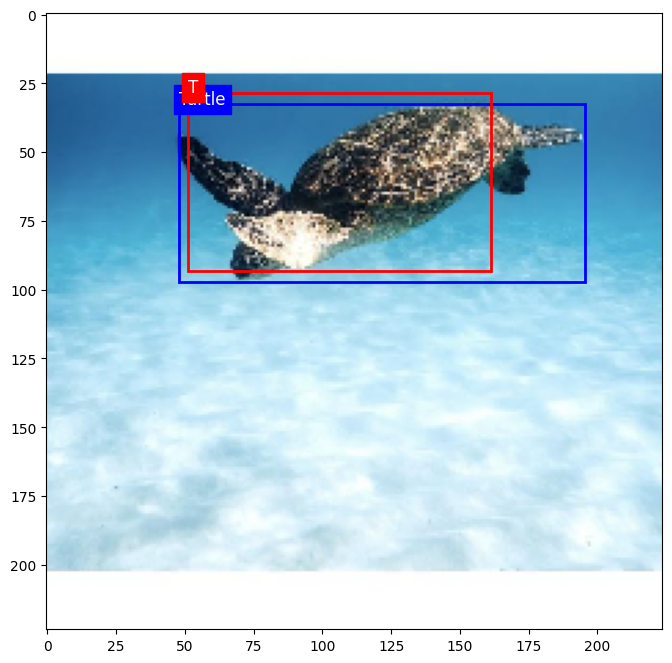

(0.7000000104308128, 102.20000267028809, 158.90000534057617, 161.0)
(9.60693883895874, 105.22398376464844, 182.88973999023438, 179.17710494995117)


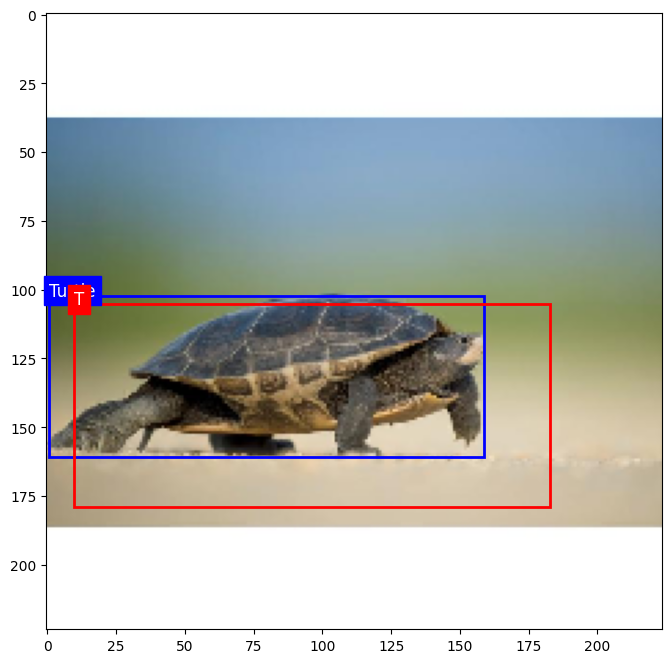

(69.29999732971191, 100.79999732971191, 164.84999465942383, 148.0499973297119)
(67.60547924041748, 96.76408386230469, 167.20133018493652, 139.14791107177734)


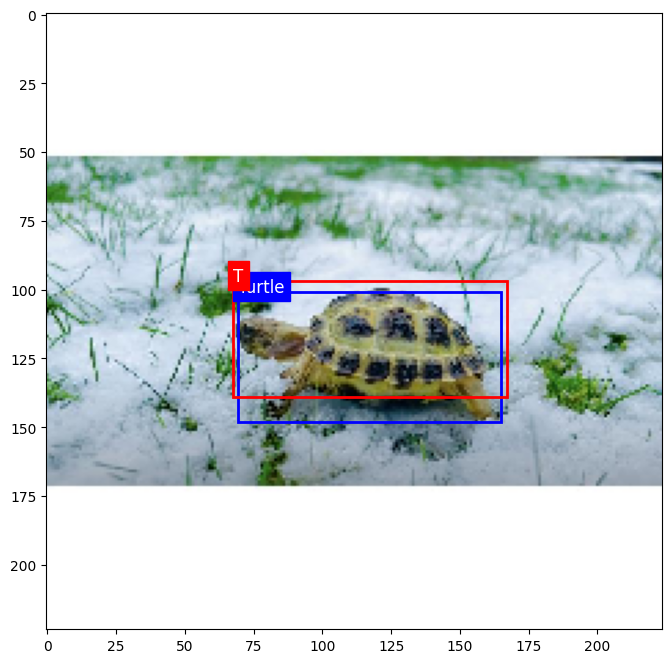

(20.30000066757202, 78.75, 92.04999732971191, 177.7999973297119)
(20.551591873168945, 71.14122104644775, 106.0178337097168, 183.23192405700684)


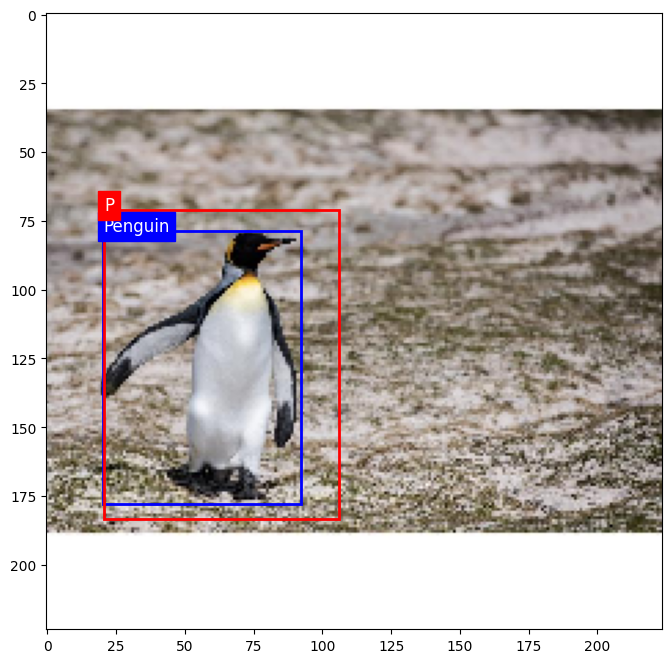

(56.700002670288086, 38.14999866485596, 179.5499973297119, 152.59999465942383)
(41.686394691467285, 27.06025719642639, 194.622652053833, 154.99934196472168)


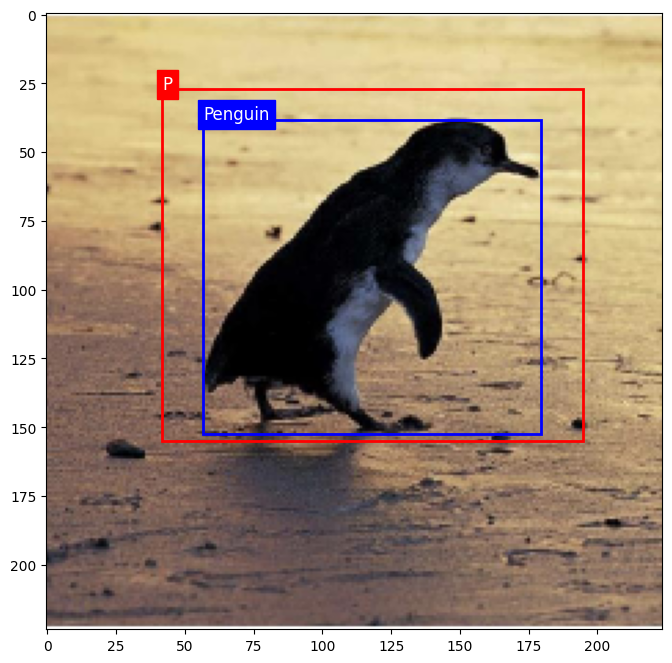

(8.049999833106995, 30.44999933242798, 196.7000026702881, 189.34999465942383)
(14.893955707550049, 44.95882272720337, 190.87073707580566, 186.7926197052002)


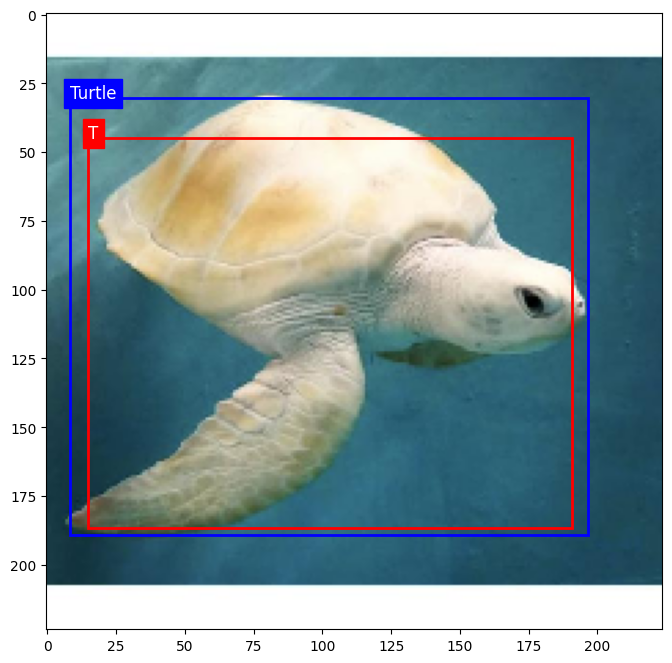

(74.54999732971191, 13.299999833106995, 195.2999973297119, 128.4500026702881)
(71.99112701416016, 21.044984340667725, 193.74610328674316, 106.39462471008301)


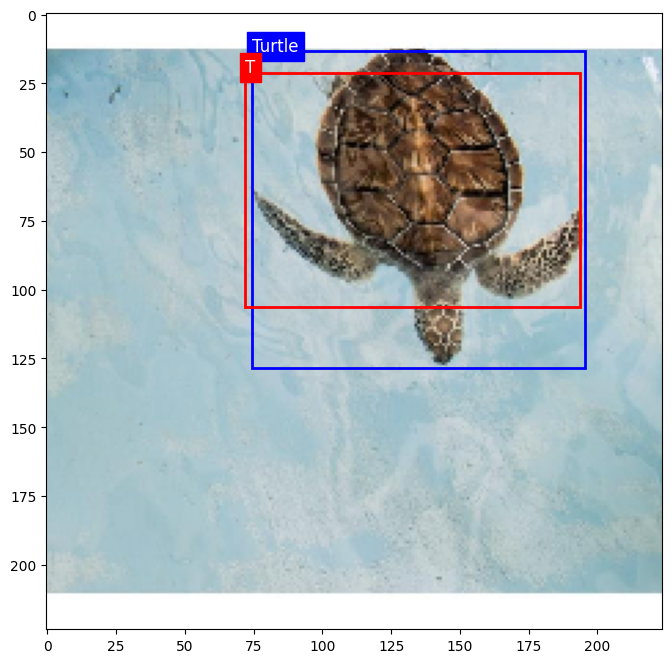

In [13]:
label_preds, bbox_preds = vgg16_tailored.predict(valid_images)
predicted_label = []
IoU = []
distance = []
for i in range(len(valid_images)):
    display_image = valid_images[i]
    display_bbox = valid_bboxes[i]
    display_label = valid_labels[i]
    
    input_image = np.expand_dims(display_image, axis=0)
    
    bbox_pred = bbox_preds[i]
    label_pred = label_preds[i]
    
    i = np.argmax(label_pred)
    label_pred = lb.classes_[i][0]
    
    if label_pred == 'P':
        predicted_label.append('Penguin')
    else:
        predicted_label.append('Turtle')
        
    IoU.append(calculate_iou(bbox_pred, display_bbox))
    distance.append(calculate_distance_between_centers(bbox_pred, display_bbox))
    
    plt.figure(figsize=(8, 8))
    plt.imshow(np.uint8(display_image*255.0))

    minx, miny, maxx, maxy = display_bbox
    print((minx*224, miny*224, maxx*224, maxy*224))
    rect = plt.Rectangle((minx*224, miny*224), (maxx - minx )*224, (maxy - miny )*224, linewidth=2, edgecolor='b', facecolor='none')
    plt.gca().add_patch(rect)
    plt.text(minx*224, miny*224, display_label, fontsize=12, color='white', backgroundcolor='blue')
    
    minx, miny, maxx, maxy = bbox_pred
    print((minx*224, miny*224, maxx*224, maxy*224))
    rect1 = plt.Rectangle((minx*224.0, miny*224.0), (maxx - minx )*224.0, (maxy - miny )*224.0, linewidth=2, edgecolor='r', facecolor='none')
    plt.gca().add_patch(rect1)
    plt.text(minx*224, miny*224, label_pred, fontsize=12, color='white', backgroundcolor='red')
    
    plt.show()
    
    


In [14]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import statistics

print(f"Confusion matrix: \n {confusion_matrix(valid_labels, predicted_label)}")
print(f"Accuracy: {accuracy_score(valid_labels, predicted_label)} \nPrecision-Penguin: {precision_score(valid_labels, predicted_label, pos_label='Penguin')} \nRecall-Penguin: {recall_score(valid_labels, predicted_label,pos_label='Penguin')} \nF1-Penguin: {f1_score(valid_labels, predicted_label, pos_label='Penguin')}\n\nPrecision-Turtle: {precision_score(valid_labels, predicted_label, pos_label='Turtle')} \nRecall-Turtle: {recall_score(valid_labels, predicted_label,pos_label='Turtle')} \nF1-Turtle: {f1_score(valid_labels, predicted_label, pos_label='Turtle')}")

iou_stdev = statistics.stdev(IoU)
iou_mean = sum(IoU)/len(IoU)
dis_stdev = statistics.stdev(distance)
dis_mean = sum(distance) / len(distance)

print(f"\nIoU standard deviation: {iou_stdev} \n \tMean: {iou_mean}")
print(f"Distance between centers of boxes: {dis_stdev}           \n \tMean: {dis_mean}")

Confusion matrix: 
 [[30  6]
 [ 1 35]]
Accuracy: 0.9027777777777778 
Precision-Penguin: 0.967741935483871 
Recall-Penguin: 0.8333333333333334 
F1-Penguin: 0.8955223880597015

Precision-Turtle: 0.8536585365853658 
Recall-Turtle: 0.9722222222222222 
F1-Turtle: 0.9090909090909091

IoU standard deviation: 0.06144579315958245 
 	Mean: 0.8753918060847299
Distance between centers of boxes: 0.03316279766098461           
 	Mean: 0.05411026793689808


# EfficientNetV2

EfficientNetV2 is an advanced convolutional neural network architecture that builds upon the original EfficientNet by improving both model efficiency and accuracy. It employs a compound scaling method that uniformly scales network dimensions (depth, width, and resolution) based on a fixed set of scaling coefficients.

### Key Features:
- **Pre-trained on ImageNet21k:** The model is pre-trained on the extensive ImageNet21k dataset, providing a strong starting point for transfer learning.
- **Compound Scaling:** Efficiently scales up model size and complexity to balance accuracy and computational cost.
- **Advanced Regularization:** Includes techniques like Dropout and Weight Decay for improved generalization.

### Implementation:
1. **Base Model:** Load EfficientNetV2S without the top layers to allow customization for specific tasks.
2. **Custom Layers:** Add GlobalAveragePooling2D, Dense layers with ReLU activation and Dropout, and a final Dense layer with softmax activation for classification.
3. **Trainable Layers:** Freeze all layers except BatchNormalization layers to retain the pre-trained knowledge while allowing some adaptation.

### Compilation and Training:
- **Optimizer:** Adam optimizer is used.
- **Learning Rate Scheduler:** Adjusts the learning rate during training to improve convergence.
- **Loss Function:** Categorical cross-entropy for classification.

EfficientNetV2 provides a high accuracy (around 91% in this case) with efficient computation, making it a robust choice for image classification tasks.


In [15]:
!pip install -U keras-efficientnet-v2
import tensorflow as tf
import keras_efficientnet_v2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.regularizers import l2

base_model = keras_efficientnet_v2.EfficientNetV2S(
    num_classes=0,
    input_shape=(224, 224, 3),
    dropout=1e-6,
    pretrained="imagenet21k"
)
initializer = tf.keras.initializers.VarianceScaling(scale=0.1, mode='fan_in', distribution='uniform')

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu', kernel_regularizer=l2(0.01))(x)
x = Dense(256, activation='relu',kernel_regularizer=l2(0.01),kernel_initializer=tf.keras.initializers.VarianceScaling(scale=0.1, mode='fan_in', distribution='uniform', seed=42)
          )(x)
predictions = Dense(2, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

for layer in model.layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True
    else:
        layer.trainable = False

epochs=5
def lr_schedule(epoch, lr):
    if epoch < 0.5 * epochs:
        return lr
    elif epoch < 0.9 * epochs:
        return lr * 0.1
    else:
        return lr * 0.01

lr_scheduler = LearningRateScheduler(lr_schedule)
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])


c:\Users\Arius\miniconda3\envs\tf-gpu-p3.9\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning: The initializer VarianceScaling is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(
Exception ignored in: <function UniquePtr.__del__ at 0x0000020BA47EB550>
Traceback (most recent call last):
  File "c:\Users\Arius\miniconda3\envs\tf-gpu-p3.9\lib\site-packages\tensorflow\python\framework\c_api_util.py", line 74, in __del__
    self.deleter(obj)
KeyboardInterrupt: 


 66134016/194646348 [=========>....................] - ETA: 39s[Error] will not load weights, url not found or download failed: https://github.com/leondgarse/keras_efficientnet_v2/releases/download/effnetv2_pretrained/efficientnetv2-s-21k.h5


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=epochs,
    validation_data=(test_images, test_labels)
)

Epoch 1/5
13/13 [==============================] - 56s 608ms/step - loss: 3.3943 - accuracy: 0.4825 - val_loss: 3.3285 - val_accuracy: 0.5100
Epoch 2/5
13/13 [==============================] - 3s 213ms/step - loss: 3.3133 - accuracy: 0.5225 - val_loss: 3.2752 - val_accuracy: 0.5200
Epoch 3/5
13/13 [==============================] - 3s 218ms/step - loss: 3.2445 - accuracy: 0.5550 - val_loss: 3.2422 - val_accuracy: 0.5300
Epoch 4/5
13/13 [==============================] - 3s 214ms/step - loss: 3.1812 - accuracy: 0.6300 - val_loss: 3.1961 - val_accuracy: 0.5700
Epoch 5/5
13/13 [==============================] - 3s 221ms/step - loss: 3.1298 - accuracy: 0.6925 - val_loss: 3.1673 - val_accuracy: 0.6200


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=epochs,
    validation_data=(test_images, test_labels)
)

Epoch 1/5
13/13 [==============================] - 3s 232ms/step - loss: 2.9194 - accuracy: 0.9625 - val_loss: 3.0120 - val_accuracy: 0.8300
Epoch 2/5
13/13 [==============================] - 3s 217ms/step - loss: 2.9089 - accuracy: 0.9575 - val_loss: 2.9894 - val_accuracy: 0.8400
Epoch 3/5
13/13 [==============================] - 3s 211ms/step - loss: 2.8835 - accuracy: 0.9725 - val_loss: 2.9713 - val_accuracy: 0.8700
Epoch 4/5
13/13 [==============================] - 3s 217ms/step - loss: 2.8604 - accuracy: 0.9775 - val_loss: 2.9527 - val_accuracy: 0.8700
Epoch 5/5
13/13 [==============================] - 3s 217ms/step - loss: 2.8371 - accuracy: 0.9900 - val_loss: 2.9344 - val_accuracy: 0.9000


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=10,
    validation_data=(test_images, test_labels)
)

Epoch 1/10
13/13 [==============================] - 3s 224ms/step - loss: 2.8240 - accuracy: 0.9875 - val_loss: 2.9232 - val_accuracy: 0.9000
Epoch 2/10
13/13 [==============================] - 3s 210ms/step - loss: 2.8102 - accuracy: 0.9900 - val_loss: 2.9093 - val_accuracy: 0.9100
Epoch 3/10
13/13 [==============================] - 3s 218ms/step - loss: 2.7928 - accuracy: 0.9950 - val_loss: 2.8965 - val_accuracy: 0.8900
Epoch 4/10
13/13 [==============================] - 3s 217ms/step - loss: 2.7791 - accuracy: 0.9950 - val_loss: 2.8842 - val_accuracy: 0.9100
Epoch 5/10
13/13 [==============================] - 3s 216ms/step - loss: 2.7582 - accuracy: 0.9950 - val_loss: 2.8674 - val_accuracy: 0.9300
Epoch 6/10
13/13 [==============================] - 3s 215ms/step - loss: 2.7491 - accuracy: 0.9975 - val_loss: 2.8601 - val_accuracy: 0.9300
Epoch 7/10
13/13 [==============================] - 3s 217ms/step - loss: 2.7368 - accuracy: 0.9950 - val_loss: 2.8480 - val_accuracy: 0.9300
Epoch 

3/3 [==============================] - 3s 326ms/step


Prediction result
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


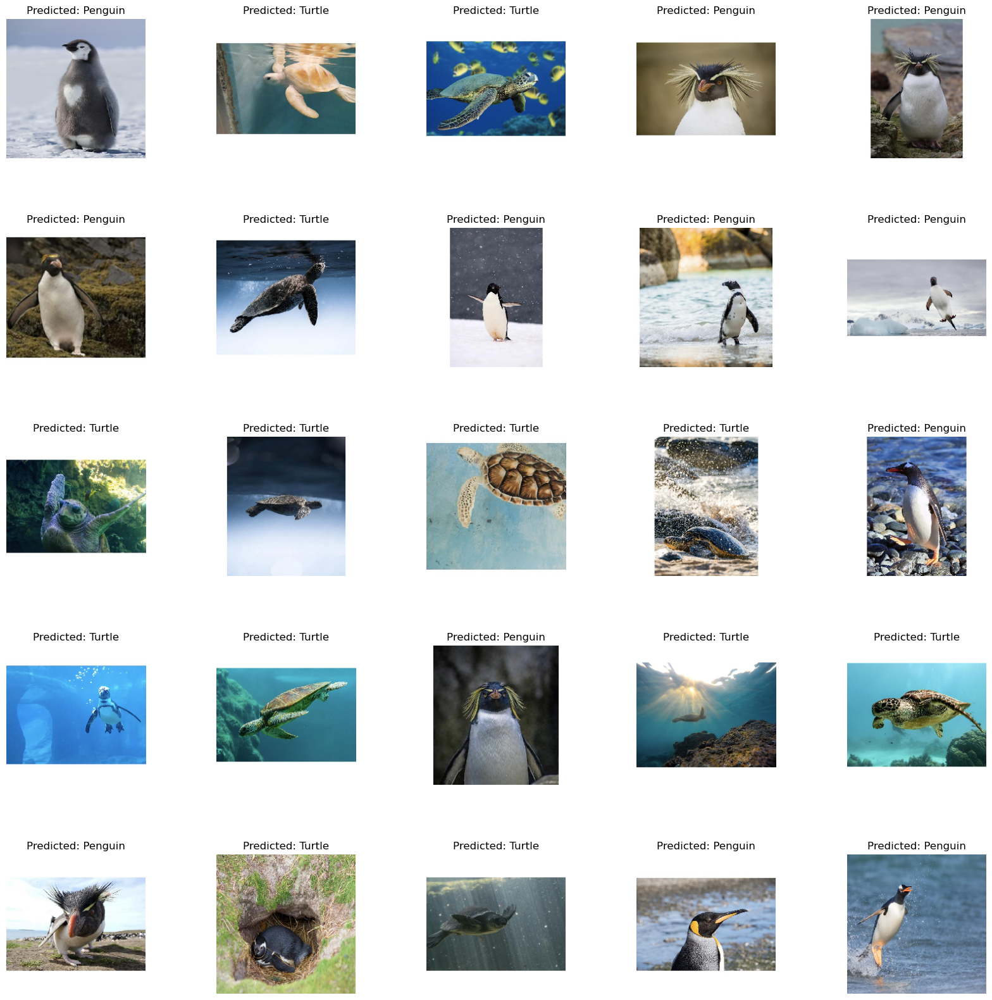

In [ ]:
predictions = model.predict(valid_images)
print("\n")
print("Prediction result")
print("-"*220)


import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec

# Convert predictions to class labels
pred_labels = np.argmax(predictions, axis=1)
pred_labels = lb.inverse_transform(pred_labels) # use the label binarizer to transform labels back to original form


rows = 5
cols = 5

fig = plt.figure(figsize=(20, 20))

# Using GridSpec to add spacing between subplots
gs = gridspec.GridSpec(rows, cols, wspace=0.5, hspace=0.5)

for i in range(rows*cols):
    img = valid_images[i] * 255.0 # Images were scaled down for training. They need to be rescaled to original form for plotting
    ax = fig.add_subplot(gs[i])
    ax.imshow(img.astype(np.uint8)) # Plot image. Cast to uint8 for proper visualization
    ax.set_title("Predicted: " + pred_labels[i]) # Set title to be the predicted label
    ax.axis('off') # Hide axes

plt.show()




### This model can only classify which to which without label box, accuracy approximately around 91%


### Define performace of EfficientNetV2S model

#### Note: As this model isn't predicting bounding boxes in the image. We can't calculate metrics like the distance between predicted and true bounding box centers or Intersection Over Union (IoU). These metrics require both the predicted and true bounding boxes.

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from tensorflow.keras.metrics import MeanIoU

# Define helper function for IoU calculation
def calc_iou_individual(pred_box, true_box):
    x1_t, y1_t, x2_t, y2_t = true_box
    x1_p, y1_p, x2_p, y2_p = pred_box

    if (x1_p > x2_t) or (y1_p > y2_t) or (x1_t > x2_p) or (y1_t > y2_p):
        return 0.0

    far_x = np.min([x2_t, x2_p])
    near_x = np.max([x1_t, x1_p])
    far_y = np.min([y2_t, y2_p])
    near_y = np.max([y1_t, y1_p])

    inter_area = (far_x - near_x + 1) * (far_y - near_y + 1)
    true_box_area = (x2_t - x1_t + 1) * (y2_t - y1_t + 1)
    pred_box_area = (x2_p - x1_p + 1) * (y2_p - y1_p + 1)
    iou = inter_area / (true_box_area + pred_box_area - inter_area)
    return iou

In [ ]:
from sklearn.preprocessing import LabelEncoder

# assuming the model predicts the class labels
predicted_labels = np.argmax(model.predict(valid_images), axis=1)

# Convert numerical labels back to original (string) labels
label_encoder = LabelEncoder()
label_encoder.fit(['Penguin', 'Turtle'])  # categories known from the problem
predicted_labels = label_encoder.inverse_transform(predicted_labels)

true_labels = valid_labels

cm = confusion_matrix(true_labels, predicted_labels)
print(f'Confusion Matrix: \n{cm}')

# calculate accuracy, precision, recall, f1-score
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='weighted')
recall = recall_score(true_labels, predicted_labels, average='weighted')
f1 = f1_score(true_labels, predicted_labels, average='weighted')

print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1-score: {f1:.4f}')


3/3 [==============================] - 0s 68ms/step
Confusion Matrix: 
[[31  5]
 [ 1 35]]
Accuracy: 0.9167
Precision: 0.9219
Recall: 0.9167
F1-score: 0.9164
